In [1]:
import xarray as xr
import NS_velocity as nsv
import numpy as np
import matplotlib.pyplot as plt


# One day 

In [17]:


filestem='https://thredds.met.no/thredds/dodsC/fou-hi/norkyst800m-1h/NorKyst-800m_ZDEPTHS_his.an.'
filetail='00.nc'

pos=np.array([60.645556,3.726389]) # lat, lon for center this is for Troll
pos=np.array([59.3057, 4.8862]) # lat, lon for Utsira, check 
span=[39,39] # grid points to each side of pos
fields=['h','u_eastward','v_northward','tke','time','zeta','u','v','w'] # fields to read
date='20220501' # date in YYYYMMDD format
filenm=filestem+date+filetail # datetime in YYYYMMDD format
data=nsv.read_one(filenm,pos=pos,span=span,fields=fields,crop_depth=False) # read data, if crop depth find the deepest level with non-missing data

In [49]:
data

<xarray.Dataset> Size: 58MB
Dimensions:      (Y: 79, X: 79, time: 24, depth: 16)
Coordinates:
  * time         (time) datetime64[ns] 192B 2022-05-01 ... 2022-05-01T23:00:00
  * X            (X) float64 632B 1.912e+05 1.92e+05 ... 2.528e+05 2.536e+05
  * Y            (Y) float64 632B 3.752e+05 3.76e+05 ... 4.368e+05 4.376e+05
  * depth        (depth) float64 128B 0.0 3.0 10.0 15.0 ... 1e+03 2e+03 3e+03
    lat          (Y, X) float64 50kB 58.94 58.94 58.95 ... 59.67 59.67 59.68
    lon          (Y, X) float64 50kB 5.143 5.149 5.155 5.161 ... 4.6 4.606 4.612
Data variables:
    h            (Y, X) float64 50kB ...
    u_eastward   (time, depth, Y, X) float32 10MB ...
    v_northward  (time, depth, Y, X) float32 10MB ...
    tke          (time, depth, Y, X) float32 10MB ...
    zeta         (time, Y, X) float32 599kB ...
    u            (time, depth, Y, X) float32 10MB -0.064 -0.079 ... nan nan
    v            (time, depth, Y, X) float32 10MB -0.097 -0.061 ... nan nan
    w            (time, depth, Y, X) float32 10MB 2.255e-08 -1.371e-09 ... nan
Attributes: (12/60)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    his_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    publisher_institution:           Norwegian Meteorological Institute (MET ...
    publisher_email:                 post@met.no
    publisher_url:                   www.met.no
    project:                         Ocean and Ice - Research to Operation (H...
    license:                         CCBY/NLOD
    DODS_EXTRA.Unlimited_Dimension:  time

In [51]:
# Sjekk hvordan X og Y faktisk varierer
print("X-koordinat ved forskjellige posisjoner:")
print(f"Rad 0, kol 0: X={data.X[0].values}, lon={data.lon[0,0].values}")
print(f"Rad 0, kol 10: X={data.X[10].values}, lon={data.lon[0,10].values}")
print(f"Rad 50, kol 0: X={data.X[0].values}, lon={data.lon[50,0].values}")

print("\nY-koordinat ved forskjellige posisjoner:")
print(f"Rad 0, kol 0: Y={data.Y[0].values}, lat={data.lat[0,0].values}")
print(f"Rad 10, kol 0: Y={data.Y[10].values}, lat={data.lat[10,0].values}")
print(f"Rad 0, kol 50: Y={data.Y[0].values}, lat={data.lat[0,50].values}")

X-koordinat ved forskjellige posisjoner:
Rad 0, kol 0: X=191200.0, lon=5.142997938819036
Rad 0, kol 10: X=199200.0, lon=5.201861023914615
Rad 50, kol 0: X=191200.0, lon=4.514098293054865

Y-koordinat ved forskjellige posisjoner:
Rad 0, kol 0: Y=375200.0, lat=58.937498109600114
Rad 10, kol 0: Y=383200.0, lat=58.96778934964718
Rad 0, kol 50: Y=375200.0, lat=59.260772762679245


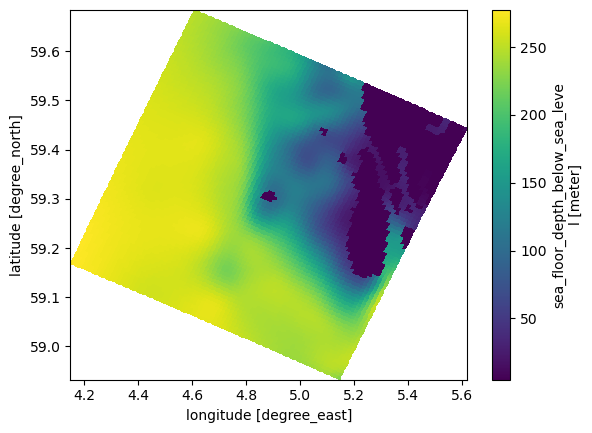

In [4]:
data.h.plot(x='lon', y='lat')

In [5]:
data['tke'] = data.tke.where(data.tke < 1e10, np.nan)    

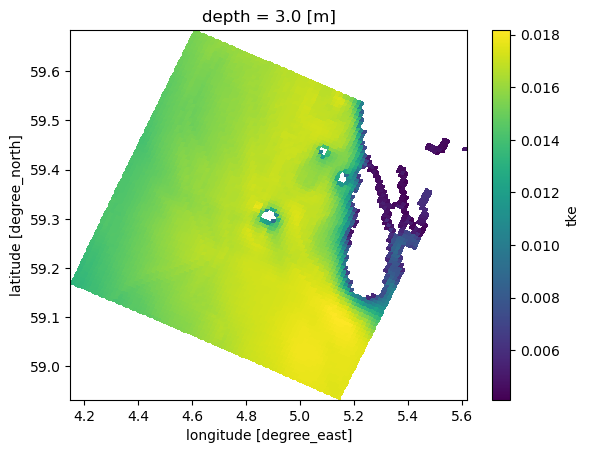

In [6]:
np.sqrt(data['tke']).mean(dim='time').isel(depth=1).plot(x='lon', y='lat')

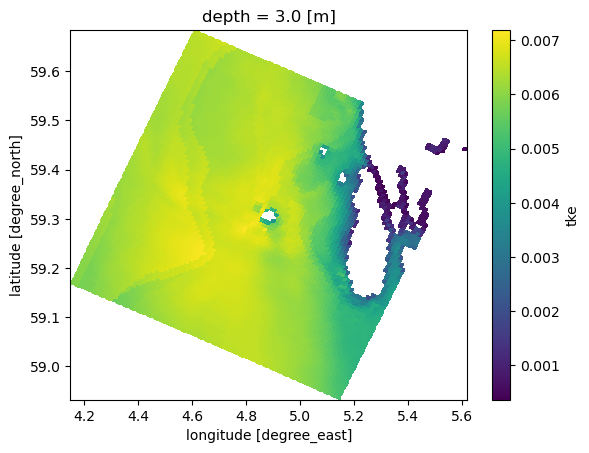

In [7]:
np.sqrt(data['tke']).std(dim='time').isel(depth=1).plot(x='lon', y='lat')

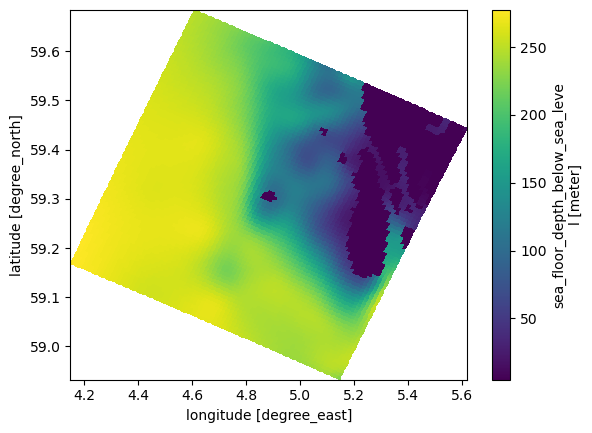

In [8]:
data.h.plot(x='lon', y='lat')

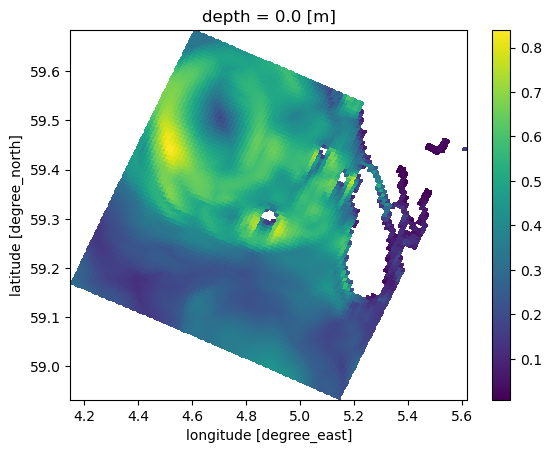

In [9]:
(np.sqrt(data.u_eastward**2 + data.v_northward**2)
    .max(dim='time')
    .isel(depth=0)
    .plot(x='lon', y='lat'))

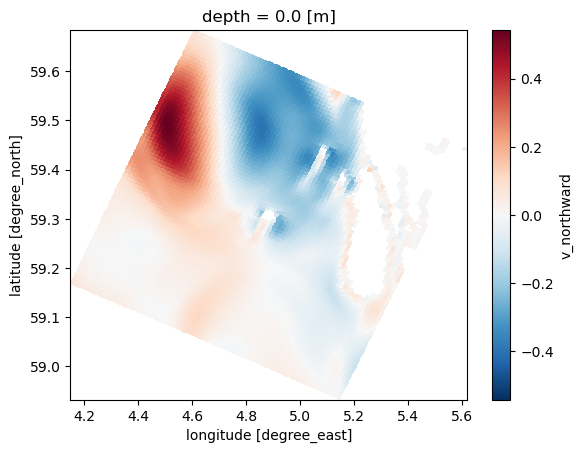

In [10]:
data.v_northward.mean(dim='time').isel(depth=0).plot(x='lon', y='lat')

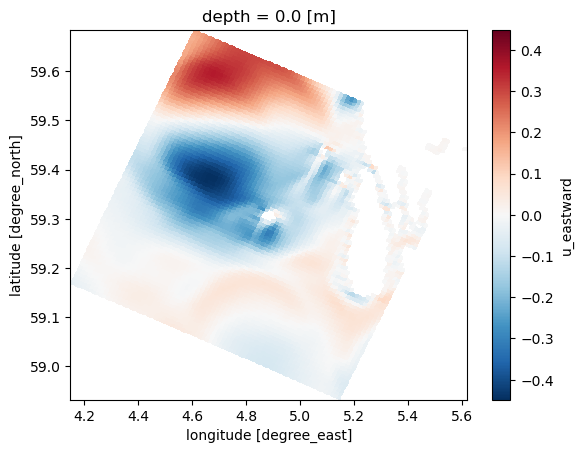

In [11]:
data.u_eastward.mean(dim='time').isel(depth=0).plot(x='lon', y='lat')

## Vorticity

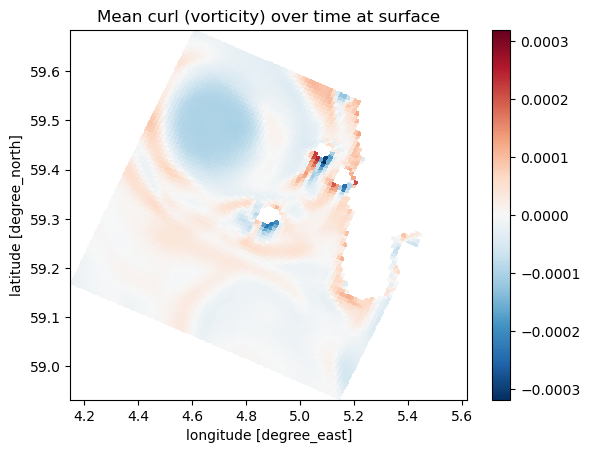

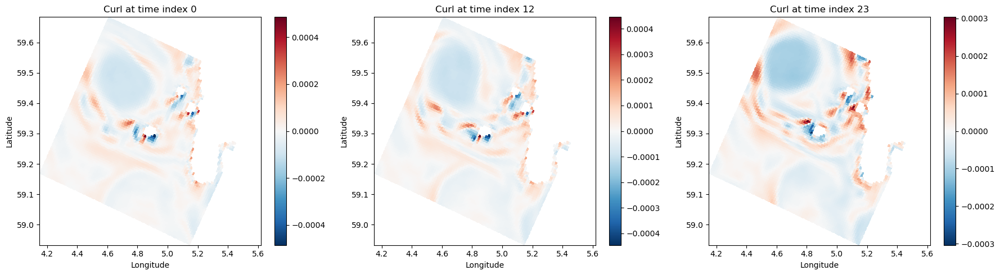

In [23]:
# Calculate the curl (vorticity) of the velocity field
du_dy = data.u.differentiate('Y')
dv_dx = data.v.differentiate('X')
du_dx= data.u.differentiate('X')
dv_dy= data.v.differentiate('Y')
curl = dv_dx - du_dy

# Plot the mean curl over time at the surface layer
curl.mean(dim='time').isel(depth=0).plot(x='lon', y='lat')
plt.title('Mean curl (vorticity) over time at surface')

# Create additional subplots showing curl at different time snapshots
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

# Select 3 time indices evenly spaced
time_indices = [0, len(data.time)//2, len(data.time)-1]

for ax, t_idx in zip(axes, time_indices):
    curl.isel(time=t_idx, depth=0).plot(x='lon', y='lat', ax=ax)
    ax.set_title(f'Curl at time index {t_idx}')
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')

plt.tight_layout()
plt.show()

## Divergence

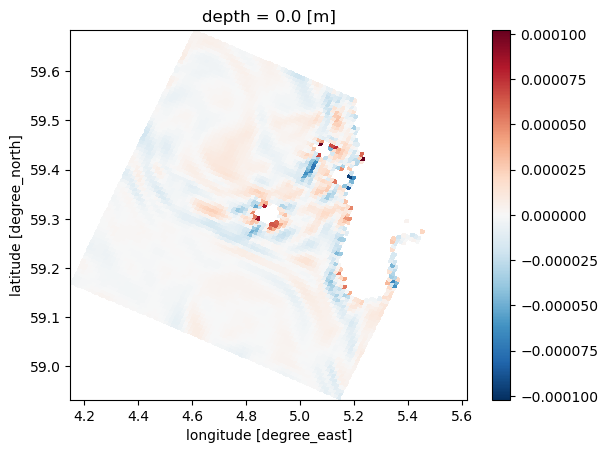

In [24]:
# Calculate the divergence of the velocity field
divergence = du_dx + dv_dy

# Plot the mean divergence over time at the surface layer
divergence.mean(dim='time').isel(depth=0).plot(x='lon', y='lat')

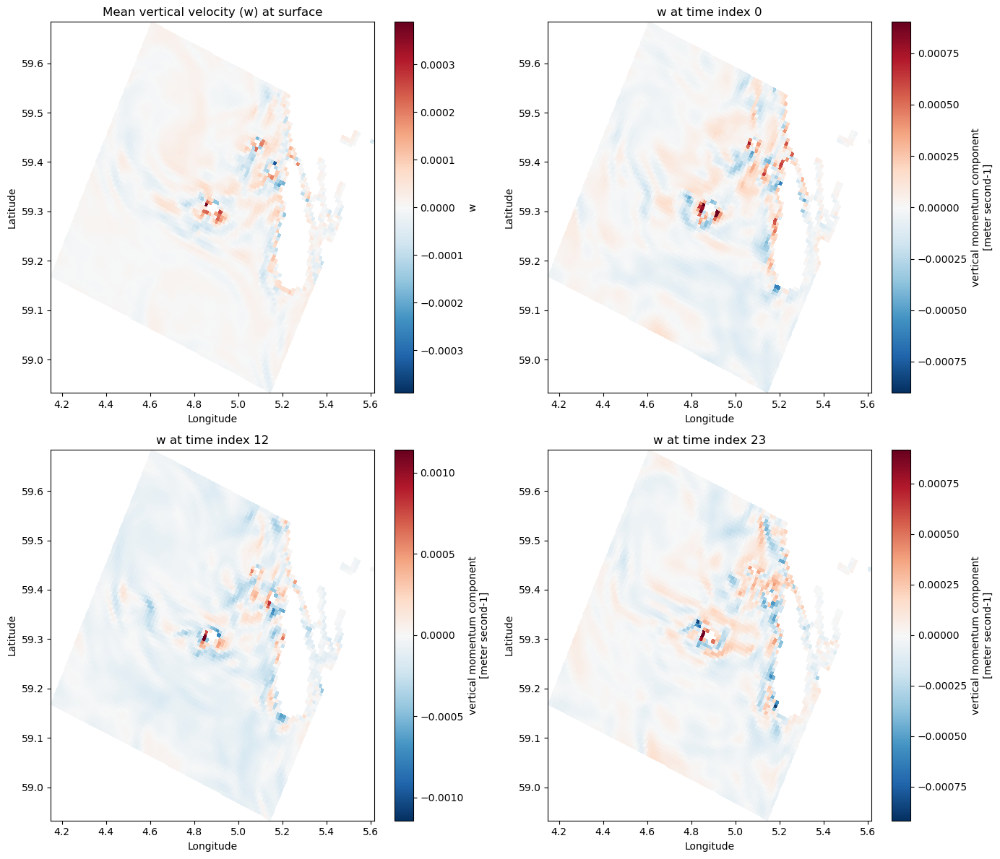

In [21]:
# Plot vertical velocity (w) at surface layer
fig, axes = plt.subplots(2, 2, figsize=(14, 12))

# Plot 1: Mean w over time
data['w'].mean(dim='time').isel(depth=1).plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[0, 0])
axes[0, 0].set_title('Mean vertical velocity (w) at surface')
axes[0, 0].set_xlabel('Longitude')
axes[0, 0].set_ylabel('Latitude')

# Plot 2: w at time index 0
data['w'].isel(time=0, depth=1).plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[0, 1])
axes[0, 1].set_title('w at time index 0')
axes[0, 1].set_xlabel('Longitude')
axes[0, 1].set_ylabel('Latitude')

# Plot 3: w at time index 12
data['w'].isel(time=12, depth=1).plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[1, 0])
axes[1, 0].set_title('w at time index 12')
axes[1, 0].set_xlabel('Longitude')
axes[1, 0].set_ylabel('Latitude')

# Plot 4: w at time index 23 (last time step)
data['w'].isel(time=23, depth=1).plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[1, 1])
axes[1, 1].set_title('w at time index 23')
axes[1, 1].set_xlabel('Longitude')
axes[1, 1].set_ylabel('Latitude')

plt.tight_layout()
plt.show()


## Zeta, surface elevation
Closed contours suggest eddies

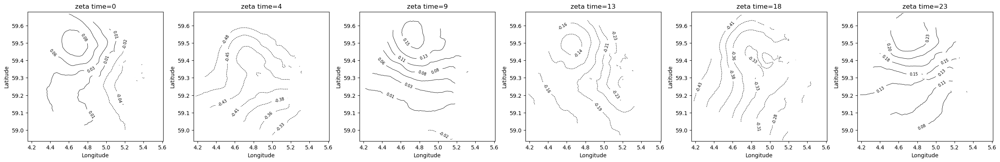

In [27]:
# Higher-resolution contour plots of sea surface height (zeta) at selected times
if 'zeta' in data.data_vars:
    zeta = data['zeta'].where(np.isfinite(data['zeta']))
    n_times = zeta.sizes.get('time', 0)
    if n_times == 0:
        print("zeta has no time dimension.")
    else:
        n_panels = min(6, n_times)
        idxs = np.linspace(0, n_times - 1, n_panels, dtype=int)

        # Refinement factor for X,Y grid
        ref_factor = 4  # increase for more interpolation refinement
        new_X = np.linspace(zeta.X.min(), zeta.X.max(), ref_factor * zeta.sizes['X'])
        new_Y = np.linspace(zeta.Y.min(), zeta.Y.max(), ref_factor * zeta.sizes['Y'])

        # Determine contour levels (broader range, more levels)
        z_sel = zeta.isel(time=idxs)
        vmin = float(z_sel.quantile(0.02))
        vmax = float(z_sel.quantile(0.98))
        levels = np.linspace(vmin, vmax, 30)

        fig, axes = plt.subplots(1, n_panels, figsize=(4.2 * n_panels, 4), constrained_layout=True)
        if n_panels == 1:
            axes = [axes]

        for ax, ti in zip(axes, idxs):
            z_fine = zeta.isel(time=ti).interp(X=new_X, Y=new_Y)
            cs = ax.contour(
                z_fine['lon'], z_fine['lat'], z_fine.values,
                levels=levels, colors='k', linewidths=0.6
            )
            ax.clabel(cs, fmt="%.2f", fontsize=7)
            ax.set_title(f'zeta time={ti}')
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')

        plt.show()
else:
    print("Variable 'zeta' not found in data_5.")

## Okubo-Weiss criterion for eddies
The **Okubo-Weiss (OW) criterion** is a diagnostic tool used in fluid dynamics to identify rotation-dominated regions (potential eddies) versus strain-dominated regions in a velocity field. It is defined as:

$$\text{OW} = s_n^2 + s_s^2 - \omega^2$$

where:
- $s_n = \frac{\partial u}{\partial x} - \frac{\partial v}{\partial y}$ is the **normal strain**
- $s_s = \frac{\partial v}{\partial x} + \frac{\partial u}{\partial y}$ is the **shear strain**  
- $\omega = \frac{\partial v}{\partial x} - \frac{\partial u}{\partial y}$ is the **vertical vorticity**

**Interpretation:**
- **OW < 0**: Rotation dominates over strain → potential **eddy** (vorticity-dominated region)
- **OW > 0**: Strain dominates over rotation → **no eddy** (deformation-dominated region)

A common threshold for eddy detection is $\text{OW} < -0.2\sigma_{\text{OW}}$, where $\sigma_{\text{OW}}$ is the standard deviation of the OW field. Regions satisfying this condition are identified as coherent vortex structures. This method is particularly useful for detecting mesoscale and submesoscale ocean eddies from velocity field data.

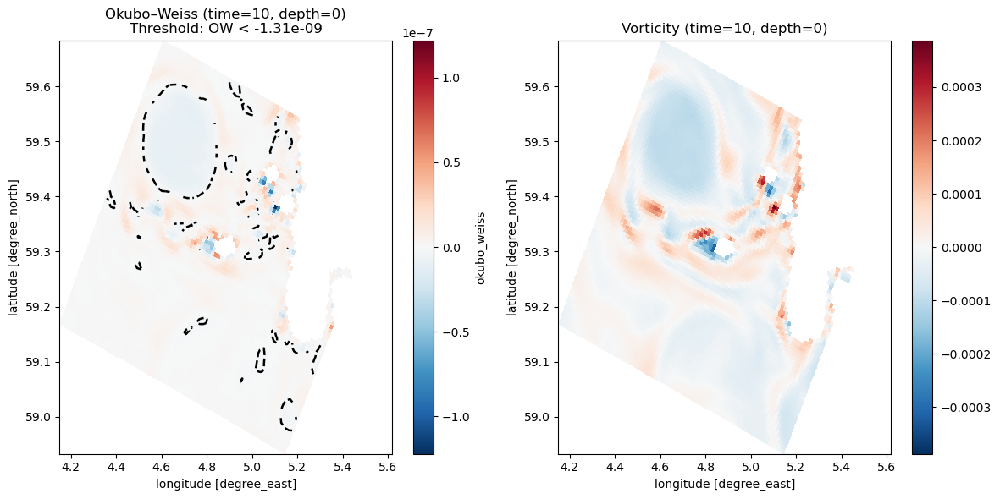

In [113]:
# Okubo–Weiss criterion at surface for selected time (uses existing time_idx)
depth_idx = 0  # surface layer index used earlier
time_idx = 10   # time index used earlier
u = data['u'].isel(time=time_idx, depth=depth_idx)
v = data['v'].isel(time=time_idx, depth=depth_idx)

# Spatial derivatives
du_dx = u.differentiate('X')
dv_dy = v.differentiate('Y')
du_dy = u.differentiate('Y')
dv_dx = v.differentiate('X')

# Strain and vorticity components
s_n = du_dx - dv_dy          # normal strain
s_s = du_dy + dv_dx          # shear strain
omega = dv_dx - du_dy        # vertical vorticity

# Okubo–Weiss parameter
OW = s_n**2 + s_s**2 - omega**2
OW.name = 'okubo_weiss'

# Threshold for rotation-dominated (eddy candidate) regions
ow_thresh = -0.2 * OW.std().item()


fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Okubo–Weiss
OW.plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[0])
axes[0].set_title(f'Okubo–Weiss (time={int(time_idx)}, depth={depth_idx})\nThreshold: OW < {ow_thresh:.2e}')
axes[0].contour(OW['lon'], OW['lat'], OW.where(OW < 0), levels=[ow_thresh], colors='k', linewidths=1.8)

# Vorticity
omega.plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[1])
axes[1].set_title(f'Vorticity (time={int(time_idx)}, depth={depth_idx})')

plt.tight_layout()
plt.show()

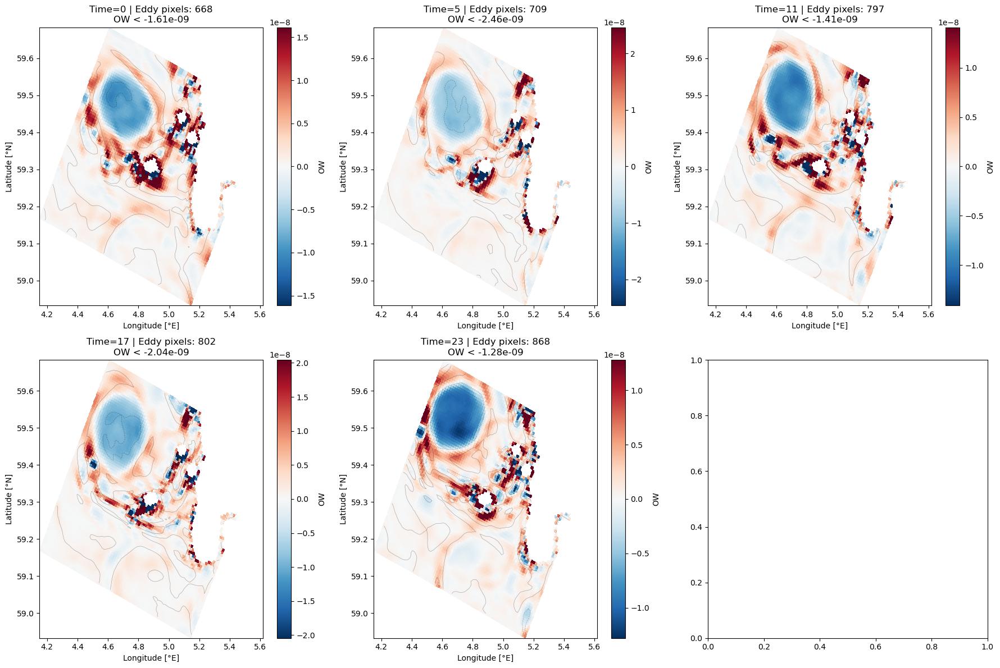


=== Okubo-Weiss Eddy Detection Statistics ===
Time     Eddy Pixels     OW Mean      OW Std       Threshold   
----------------------------------------------------------------------
0        668             1.207e-09    8.075e-09    -1.615e-09  
5        709             3.656e-10    1.230e-08    -2.460e-09  
11       797             7.415e-10    7.053e-09    -1.411e-09  
17       802             3.545e-10    1.022e-08    -2.043e-09  
23       868             5.278e-10    6.388e-09    -1.278e-09  


In [115]:

def compute_okubo_weiss(u, v, dx=None, dy=None):
    """
    Compute Okubo-Weiss parameter for detecting rotation-dominated regions (eddies).
    
    OW = s_n^2 + s_s^2 - omega^2
    
    where:
    - s_n = du/dx - dv/dy (normal strain)
    - s_s = dv/dx + du/dy (shear strain)  
    - omega = dv/dx - du/dy (vertical vorticity)
    
    OW < 0: rotation-dominated (eddy candidate)
    OW > 0: strain-dominated
    
    Parameters:
    -----------
    u : xarray.DataArray
        Eastward velocity component
    v : xarray.DataArray  
        Northward velocity component
    dx, dy : float, optional
        Grid spacing (if not using differentiate method)
        
    Returns:
    --------
    OW : xarray.DataArray
        Okubo-Weiss parameter field
    omega : xarray.DataArray
        Vorticity field
    s_n : xarray.DataArray
        Normal strain
    s_s : xarray.DataArray
        Shear strain
    """
    # Compute spatial derivatives
    du_dx = u.differentiate('X')
    dv_dy = v.differentiate('Y')
    du_dy = u.differentiate('Y')
    dv_dx = v.differentiate('X')
    
    # Strain rate components
    s_n = du_dx - dv_dy  # normal strain
    s_s = du_dy + dv_dx  # shear strain
    omega = dv_dx - du_dy  # vertical vorticity
    
    # Okubo-Weiss parameter
    OW = s_n**2 + s_s**2 - omega**2
    OW.name = 'okubo_weiss'
    
    return OW, omega, s_n, s_s

# Analyze multiple time steps for eddy detection
depth_idx = 0  # surface layer

# Select time indices to analyze
time_indices = [0, 5, 11, 17, 23]

n_times = len(time_indices)

fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

eddy_stats = []

for i, time_idx in enumerate(time_indices):
    u = data['u'].isel(time=time_idx, depth=depth_idx)
    v = data['v'].isel(time=time_idx, depth=depth_idx)
    
    # Compute Okubo-Weiss
    OW, omega, s_n, s_s = compute_okubo_weiss(u, v)
    
    # Threshold for eddy detection (typically -0.2*sigma to -1.0*sigma)
    ow_std = OW.std().item()
    ow_thresh = -0.2 * ow_std
    
    # Count eddy pixels
    eddy_mask = OW < ow_thresh
    n_eddy_pixels = int(eddy_mask.sum().item())
    
    eddy_stats.append({
        'time_idx': time_idx,
        'n_pixels': n_eddy_pixels,
        'ow_mean': float(OW.mean().item()),
        'ow_std': ow_std,
        'threshold': ow_thresh
    })
    
    # Plot
    im = OW.plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[i], 
                 add_colorbar=False, vmin=-2*ow_std, vmax=2*ow_std)
    plt.colorbar(im, ax=axes[i], label='OW')
    
    # Contour eddy regions
    axes[i].contour(OW['lon'], OW['lat'], 
                    OW.where(OW < ow_thresh), 
                    levels=[ow_thresh], 
                    colors='lime', 
                    linewidths=2.5,
                    linestyles='-')
    
    # Overlay vorticity contours
    axes[i].contour(omega['lon'], omega['lat'], omega, 
                    levels=10, colors='k', linewidths=0.5, alpha=0.3)
    
    axes[i].set_title(f'Time={time_idx} | Eddy pixels: {n_eddy_pixels}\nOW < {ow_thresh:.2e}')
    axes[i].set_xlabel('Longitude [°E]')
    axes[i].set_ylabel('Latitude [°N]')

plt.tight_layout()
plt.show()

# Print statistics
print("\n=== Okubo-Weiss Eddy Detection Statistics ===")
print(f"{'Time':<8} {'Eddy Pixels':<15} {'OW Mean':<12} {'OW Std':<12} {'Threshold':<12}")
print("-" * 70)
for stat in eddy_stats:
    print(f"{stat['time_idx']:<8} {stat['n_pixels']:<15} "
          f"{stat['ow_mean']:<12.3e} {stat['ow_std']:<12.3e} {stat['threshold']:<12.3e}")

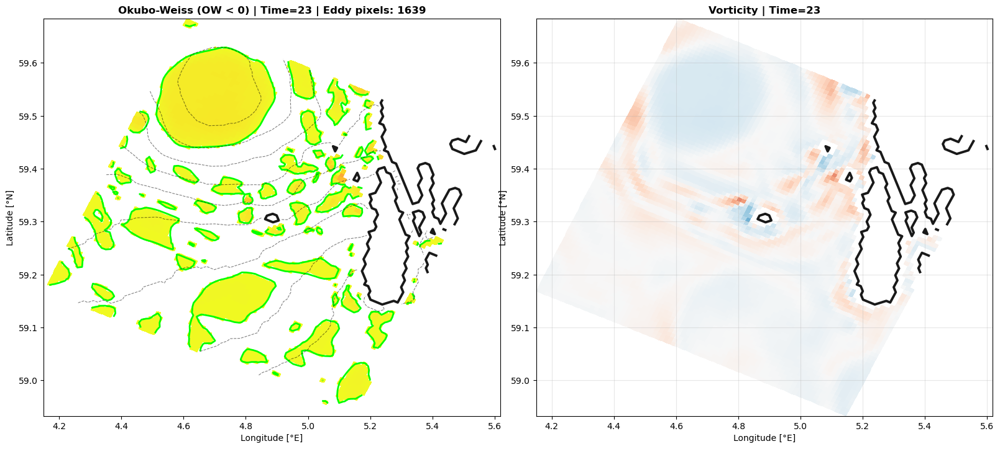

In [142]:
import numpy as np
from IPython.display import HTML

import matplotlib.pyplot as plt
import matplotlib.animation as animation

# Function to compute Okubo-Weiss parameter
def compute_okubo_weiss_simple(u, v):
    """Compute Okubo-Weiss parameter from velocity fields"""
    du_dx = u.differentiate('X')
    dv_dy = v.differentiate('Y')
    du_dy = u.differentiate('Y')
    dv_dx = v.differentiate('X')
    
    s_n = du_dx - dv_dy  # normal strain
    s_s = du_dy + dv_dx  # shear strain
    omega = dv_dx - du_dy  # vertical vorticity
    
    OW = s_n**2 + s_s**2 - omega**2
    OW.name = 'okubo_weiss'
    
    return OW, omega

# Select time range and depth
depth_idx = 0
time_start = 0
time_end = min(24, data.sizes['time'])  # First 24 hours or less
time_indices = range(time_start, time_end)

# Prepare figure
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 7))

# Initialize empty plots
im1 = None
im2 = None
contour1 = None
contour2 = None

# Compute global colorbar limits across all timesteps
ow_min_global = 0
ow_max_global = 0
omega_min_global = float('inf')
omega_max_global = float('-inf')

for time_idx in time_indices:
    u = data['u'].isel(time=time_idx, depth=depth_idx)
    v = data['v'].isel(time=time_idx, depth=depth_idx)
    OW, omega = compute_okubo_weiss_simple(u, v)
    
    ow_min_global = min(ow_min_global, OW.min().item())
    omega_min_global = min(omega_min_global, omega.min().item())
    omega_max_global = max(omega_max_global, omega.max().item())

vmax_omega = max(abs(omega_min_global), abs(omega_max_global))

def init():
    """Initialize animation"""
    return []

def animate(frame_idx):
    """Animation function"""
    global im1, im2, contour1, contour2
    
    time_idx = time_indices[frame_idx]
    
    # Get velocity at this time
    u = data['u'].isel(time=time_idx, depth=depth_idx)
    v = data['v'].isel(time=time_idx, depth=depth_idx)
    
    # Compute Okubo-Weiss
    OW, omega = compute_okubo_weiss_simple(u, v)
    
    # Threshold for eddies (rotation-dominated regions: OW < 0)
    ow_std = OW.std().item()
    ow_thresh = -0.2 * ow_std*0
    
    # Count eddy pixels
    eddy_mask = OW < ow_thresh
    n_eddy_pixels = int(eddy_mask.sum().item())
    
    # Clear axes
    ax1.clear()
    ax2.clear()
    
    # Plot only negative OW values
    OW_negative = OW.where(OW < ow_thresh)
    im1 = ax1.pcolormesh(OW['lon'], OW['lat'], OW_negative.values, 
                         cmap='plasma', shading='auto',
                         vmin=ow_min_global*0.8, vmax=0)
    
    # Contour eddy regions
    if n_eddy_pixels > 0:
        ax1.contour(OW['lon'], OW['lat'], 
                    OW.where(OW < ow_thresh+0.1).values, 
                    levels=[ow_thresh], 
                    colors='lime', 
                    linewidths=2,
                    linestyles='-')
    
    ax1.set_title(f'Okubo-Weiss (OW < 0) | Time={time_idx} | Eddy pixels: {n_eddy_pixels}', 
                  fontsize=12, fontweight='bold')
    ax1.set_xlabel('Longitude [°E]')
    ax1.set_ylabel('Latitude [°N]')
    ax1.grid(True, alpha=0.3)
    # Add surface elevation (zeta) contours
    # Get zeta for this time
    zeta = data['zeta'].isel(time=time_idx)
    # Black out land using mask from zeta
    # Land mask: where both u and v are always zero (across all times)
    u_all = data['u'].isel(depth=depth_idx)
    v_all = data['v'].isel(depth=depth_idx)
    
    # Create land mask
    land_mask = np.isnan(u_all.isel(time=0).values) | np.isnan(v_all.isel(time=0).values)
    #ax1.pcolor(zeta['lon'], zeta['lat'], land_mask, cmap='gray', shading='auto', vmin=0, vmax=1, alpha=0.8)
    ax1.contour(zeta['lon'], zeta['lat'], zeta.values, 
                levels=10, colors='black', linewidths=0.8, 
                alpha=0.5, linestyles='--')
    ax1.contour(zeta['lon'], zeta['lat'], data.h.values, 
                levels=[5], colors='black', linewidths=2.8, 
                alpha=0.9, linestyles='-')
    ax1.grid(False)
    # Plot vorticity with consistent colorbar
    im2 = ax2.pcolormesh(omega['lon'], omega['lat'], omega.values,
                         cmap='RdBu_r', shading='auto',
                         vmin=-vmax_omega, vmax=vmax_omega)
    
    ax2.set_title(f'Vorticity | Time={time_idx}', 
                  fontsize=12, fontweight='bold')
    ax2.contour(zeta['lon'], zeta['lat'], data.h.values, 
                levels=[5], colors='black', linewidths=2.8, 
                alpha=0.9, linestyles='-')
    ax2.set_xlabel('Longitude [°E]')
    ax2.set_ylabel('Latitude [°N]')
    ax2.grid(True, alpha=0.3)
    
    return [im1, im2]

# Create animation
anim = animation.FuncAnimation(fig, animate, init_func=init,
                               frames=len(time_indices), 
                               interval=500,  # 500ms between frames
                               blit=False, repeat=True)

plt.tight_layout()

# Display animation in notebook
HTML(anim.to_jshtml())

## Helmholtz-Hodge
Denne her inneholder en fortegnsfeil. 

Grid spacing: dx=800.0 m, dy=800.0 m

Helmholtz–Hodge decomposition (KORREKT grid-spacing)
time_idx=23, depth_idx=1
Energy % -> Irrotational: 5.76  Solenoidal: 81.04  Harmonic: 17.91
Sum: 104.70% (should be 100%)


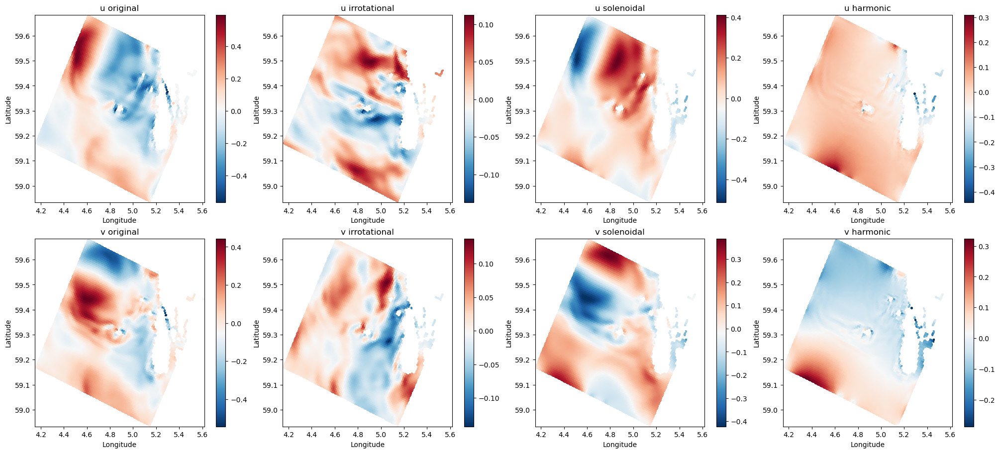

In [144]:
# Helmholtz–Hodge decomposition RIKTIG versjon 2: Korrekt grid-spacing

try:
    time_idx
except NameError:
    time_idx = 1

depth_idx = 1

# ✓ Bruk NATIVE grid-hastigheter
u = data['u'].isel(time=time_idx, depth=depth_idx)
v = data['v'].isel(time=time_idx, depth=depth_idx)

mask = np.isnan(u.values) | np.isnan(v.values)
u_f = np.where(mask, 0.0, u.values)
v_f = np.where(mask, 0.0, v.values)

# ✓✓ FIKSET: Beregn grid-spacing KORREKT
x = u['X'].values  # 1D array
y = u['Y'].values  # 1D array

# Grid-spacing er KONSTANT (uniform grid)
dx = float(x[1] - x[0])  # Avstand mellom grid-punkter
dy = float(y[1] - y[0])

print(f"Grid spacing: dx={dx:.1f} m, dy={dy:.1f} m")

# ✓✓ Nå er gradient korrekt!
du_dx = np.gradient(u_f, dx, axis=1)  # dx langs X-aksen (kolonne)
dv_dy = np.gradient(v_f, dy, axis=0)  # dy langs Y-aksen (rad)
dv_dx = np.gradient(v_f, dx, axis=1)
du_dy = np.gradient(u_f, dy, axis=0)

div = du_dx + dv_dy
curl = dv_dx - du_dy

# FFT decomposition (uendret)
ny, nx = div.shape
kx = np.fft.fftfreq(nx, d=dx) * 2 * np.pi
ky = np.fft.fftfreq(ny, d=dy) * 2 * np.pi
KX, KY = np.meshgrid(kx, ky)
k2 = KX**2 + KY**2
k2[0, 0] = 1.0

div_k = np.fft.fft2(div)
curl_k = np.fft.fft2(curl)

phi_k = -div_k / k2
psi_k = -curl_k / k2

phi_k[0, 0] = 0.0
psi_k[0, 0] = 0.0

phi = np.real(np.fft.ifft2(phi_k))
psi = np.real(np.fft.ifft2(psi_k))

dphi_dx = np.gradient(phi, dx, axis=1)
dphi_dy = np.gradient(phi, dy, axis=0)
dpsi_dx = np.gradient(psi, dx, axis=1)
dpsi_dy = np.gradient(psi, dy, axis=0)

u_irrot = dphi_dx
v_irrot = dphi_dy
u_sol = dpsi_dy
v_sol = -dpsi_dx

u_harm = u_f - (u_irrot - u_sol)
v_harm = v_f - (v_irrot - v_sol)

for arr in [u_f, v_f, u_irrot, v_irrot, u_sol, v_sol, u_harm, v_harm]:
    arr[mask] = np.nan

def energy(a, b):
    return np.nansum(a**2 + b**2)

E_tot = energy(u_f, v_f)
E_irrot = energy(u_irrot, v_irrot) / E_tot * 100.0
E_sol = energy(u_sol, v_sol) / E_tot * 100.0
E_harm = energy(u_harm, v_harm) / E_tot * 100.0

print(f"\nHelmholtz–Hodge decomposition (KORREKT grid-spacing)")
print(f"time_idx={time_idx}, depth_idx={depth_idx}")
print(f"Energy % -> Irrotational: {E_irrot:.2f}  Solenoidal: {E_sol:.2f}  Harmonic: {E_harm:.2f}")
print(f"Sum: {E_irrot + E_sol + E_harm:.2f}% (should be 100%)")

# Plot
fig, axes = plt.subplots(2, 4, figsize=(20, 9), constrained_layout=True)
cm = 'RdBu_r'

im0 = axes[0,0].pcolormesh(u['lon'], u['lat'], u.values, cmap=cm, shading='auto')
axes[0,0].set_title('u original'); plt.colorbar(im0, ax=axes[0,0])

im1 = axes[0,1].pcolormesh(u['lon'], u['lat'], u_irrot, cmap=cm, shading='auto')
axes[0,1].set_title('u irrotational'); plt.colorbar(im1, ax=axes[0,1])

im2 = axes[0,2].pcolormesh(u['lon'], u['lat'], u_sol, cmap=cm, shading='auto')
axes[0,2].set_title('u solenoidal'); plt.colorbar(im2, ax=axes[0,2])

im6 = axes[0,3].pcolormesh(u['lon'], u['lat'], u_harm, cmap=cm, shading='auto')
axes[0,3].set_title('u harmonic'); plt.colorbar(im6, ax=axes[0,3])

im3 = axes[1,0].pcolormesh(v['lon'], v['lat'], v.values, cmap=cm, shading='auto')
axes[1,0].set_title('v original'); plt.colorbar(im3, ax=axes[1,0])

im4 = axes[1,1].pcolormesh(v['lon'], v['lat'], v_irrot, cmap=cm, shading='auto')
axes[1,1].set_title('v irrotational'); plt.colorbar(im4, ax=axes[1,1])

im5 = axes[1,2].pcolormesh(v['lon'], v['lat'], v_sol, cmap=cm, shading='auto')
axes[1,2].set_title('v solenoidal'); plt.colorbar(im5, ax=axes[1,2])

im7 = axes[1,3].pcolormesh(v['lon'], v['lat'], v_harm, cmap=cm, shading='auto')
axes[1,3].set_title('v harmonic'); plt.colorbar(im7, ax=axes[1,3])

for ax in axes.flat:
    ax.set_xlabel('Longitude'); ax.set_ylabel('Latitude')

plt.show()

In [145]:
print(f'E_harm={E_harm:.2f} %')
print(f'E_irrot={E_irrot:.2f} %')
print(f'E_sol={E_sol:.2f} %')   
print(f'E_tot={E_tot:.2f} %')

E_harm=17.91 %
E_irrot=5.76 %
E_sol=81.04 %
E_tot=312.44 %


u_irr

## Lagrangian Coherent Structures
**Lagrangian Coherent Structures (LCS)** are dynamic boundaries in fluid flows that act as transport barriers, separating regions with qualitatively different flow behaviors. They represent the skeleton of Lagrangian dynamics and reveal how fluid parcels are stirred, mixed, or transported over time. LCS are typically identified by computing the **Finite-Time Lyapunov Exponent (FTLE)**, which measures the rate of separation between initially nearby fluid particles over a finite time interval. Ridges in the FTLE field correspond to LCS: **forward-time FTLE** reveals **repelling structures** (unstable manifolds) that push particles apart, while **backward-time FTLE** identifies **attracting structures** (stable manifolds) that pull particles together. These structures are crucial for understanding coherent patterns such as eddies, fronts, and filaments in geophysical flows, and are particularly useful for predicting pollutant dispersion, larval transport, and the formation of convergence zones in ocean dynamics.

I don't understand why this one gives the same forward and backward

Computing FTLE fields (this may take a few minutes)...
Integration time: 1.0 days (24 steps)
FTLE computation complete!


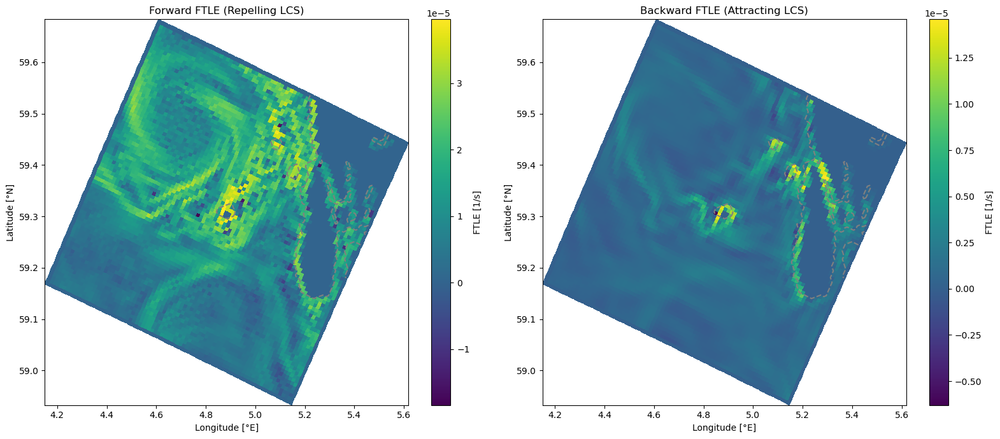

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3326229787.py:144: UserWarning: The following kwargs were not used by contour: 'label'
  axes[0].contour(lon, lat, ridge_fwd, levels=[0.5], colors='white',
/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3326229787.py:157: UserWarning: The following kwargs were not used by contour: 'label'
  axes[1].contour(lon, lat, ridge_bwd, levels=[0.5], colors='white',


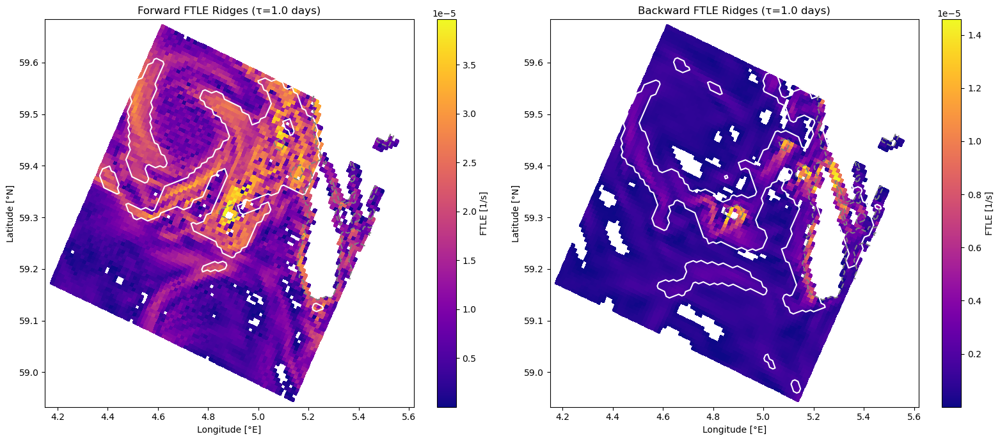

LCS analysis complete using X,Y coordinates
Integration time: 1.0 days (24 steps)
Start time index: 0


In [151]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.ndimage import gaussian_filter

# Lagrangian Coherent Structures (LCS) using X,Y coordinates and u,v velocities

# Set parameters for FTLE computation
start_idx = 0  # Starting time index
tau_days = 1.0  # Integration time in days
dt_hours = 1.0  # Time step in hours (data frequency)
tau_steps = int(tau_days * 24 / dt_hours)  # Number of time steps

depth_idx = 0  # Surface layer

# Get velocity field dimensions
ny, nx = data['u'].isel(time=0, depth=depth_idx).shape
lon = data['lon'].values
lat = data['lat'].values

# Create land mask
u_sample = data['u'].isel(time=start_idx, depth=depth_idx).values
v_sample = data['v'].isel(time=start_idx, depth=depth_idx).values
land_mask = np.isnan(u_sample) | np.isnan(v_sample)

# Simple Lagrangian particle advection
def advect_particles(x0, y0, direction=1):
    """Advect particles forward (direction=1) or backward (direction=-1)"""
    x = x0.copy()
    y = y0.copy()
    
    for step in range(tau_steps):
        t_idx = start_idx + direction * step
        if t_idx < 0 or t_idx >= len(data.time):
            break
            
        u_field = data['u'].isel(time=t_idx, depth=depth_idx).values
        v_field = data['v'].isel(time=t_idx, depth=depth_idx).values
        
        # Replace NaN with 0
        u_field = np.where(np.isnan(u_field), 0, u_field)
        v_field = np.where(np.isnan(v_field), 0, v_field)
        
        # Interpolate velocity at particle positions
        # For simplicity, use nearest grid point
        i_idx = np.clip(np.round((y - data.Y.values[0]) / 800.0).astype(int), 0, ny-1)
        j_idx = np.clip(np.round((x - data.X.values[0]) / 800.0).astype(int), 0, nx-1)
        
        u = u_field[i_idx, j_idx]
        v = v_field[i_idx, j_idx]
        
        # Simple Euler integration
        x += direction * u * dt_hours * 3600  # Convert hours to seconds
        y += direction * v * dt_hours * 3600
    
    return x, y

# Compute FTLE by finite differences
def compute_ftle(direction=1):
    """Compute FTLE field"""
    ftle = np.zeros((ny, nx))
    
    # Grid spacing
    dx = 800.0  # meters
    dy = 800.0  # meters
    eps = dx  # Perturbation size
    
    for i in range(1, ny-1):
        for j in range(1, nx-1):
            # Get initial positions for this grid point
            x0 = data.X.values[j]
            y0 = data.Y.values[i]
            
            # Advect center point and perturbed points
            x_c, y_c = advect_particles(np.array([x0]), np.array([y0]), direction)
            x_px, y_px = advect_particles(np.array([x0 + eps]), np.array([y0]), direction)
            x_py, y_py = advect_particles(np.array([x0]), np.array([y0 + eps]), direction)
            
            # Compute flow map gradient
            dx_dx = (x_px[0] - x_c[0]) / eps
            dy_dx = (y_px[0] - y_c[0]) / eps
            dx_dy = (x_py[0] - x_c[0]) / eps
            dy_dy = (y_py[0] - y_c[0]) / eps
            
            # Cauchy-Green strain tensor
            C11 = dx_dx**2 + dy_dx**2
            C12 = dx_dx*dx_dy + dy_dx*dy_dy
            C22 = dx_dy**2 + dy_dy**2
            
            # Maximum eigenvalue
            lambda_max = 0.5 * (C11 + C22 + np.sqrt((C11 - C22)**2 + 4*C12**2))
            
            # FTLE
            if lambda_max > 0:
                ftle[i, j] = np.log(np.sqrt(lambda_max)) / (tau_days * 86400)  # per second
            else:
                ftle[i, j] = 0
    
    return ftle

print(f"Computing FTLE fields (this may take a few minutes)...")
print(f"Integration time: {tau_days:.1f} days ({tau_steps} steps)")

# Compute forward and backward FTLE
ftle_forward = compute_ftle(direction=1)
ftle_backward = compute_ftle(direction=-1)

# Detect ridges (simple approach: local maxima)
ridge_fwd = gaussian_filter(ftle_forward, sigma=1.5) > np.percentile(ftle_forward[~land_mask], 75)
ridge_bwd = gaussian_filter(ftle_backward, sigma=1.5) > np.percentile(ftle_backward[~land_mask], 75)

print("FTLE computation complete!")

# Create figure with forward and backward FTLE
fig, axes = plt.subplots(1, 2, figsize=(16, 7))

# Forward FTLE (repelling structures)
im1 = axes[0].pcolormesh(lon, lat, ftle_forward, shading='auto', cmap='viridis')
axes[0].set_title('Forward FTLE (Repelling LCS)')
axes[0].set_xlabel('Longitude [°E]')
axes[0].set_ylabel('Latitude [°N]')
plt.colorbar(im1, ax=axes[0], label='FTLE [1/s]')
axes[0].contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
                linewidths=1.5, linestyles='--')

# Backward FTLE (attracting structures)
im2 = axes[1].pcolormesh(lon, lat, ftle_backward, shading='auto', cmap='viridis')
axes[1].set_title('Backward FTLE (Attracting LCS)')
axes[1].set_xlabel('Longitude [°E]')
axes[1].set_ylabel('Latitude [°N]')
plt.colorbar(im2, ax=axes[1], label='FTLE [1/s]')
axes[1].contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
                linewidths=1.5, linestyles='--')

plt.tight_layout()
plt.show()

# Plot ridges (high FTLE regions indicating LCS)
fig, axes = plt.subplots(1, 2, figsize=(16, 7))

# Forward FTLE with ridges
ftle_fwd_pos = np.where(ftle_forward > 0, ftle_forward, np.nan)
im1 = axes[0].pcolormesh(lon, lat, ftle_fwd_pos, shading='auto', cmap='plasma')
if ridge_fwd is not None and ridge_fwd.any():
    axes[0].contour(lon, lat, ridge_fwd, levels=[0.5], colors='white', 
                    linewidths=1.5, label='LCS ridges')
axes[0].contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
                linewidths=1.5, linestyles='--')
axes[0].set_title(f'Forward FTLE Ridges (τ={tau_days:.1f} days)')
axes[0].set_xlabel('Longitude [°E]')
axes[0].set_ylabel('Latitude [°N]')
plt.colorbar(im1, ax=axes[0], label='FTLE [1/s]')

# Backward FTLE with ridges
ftle_bwd_pos = np.where(ftle_backward > 0, ftle_backward, np.nan)
im2 = axes[1].pcolormesh(lon, lat, ftle_bwd_pos, shading='auto', cmap='plasma')
if ridge_bwd is not None and ridge_bwd.any():
    axes[1].contour(lon, lat, ridge_bwd, levels=[0.5], colors='white', 
                    linewidths=1.5, label='LCS ridges')
axes[1].contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
                linewidths=1.5, linestyles='--')
axes[1].set_title(f'Backward FTLE Ridges (τ={tau_days:.1f} days)')
axes[1].set_xlabel('Longitude [°E]')
axes[1].set_ylabel('Latitude [°N]')
plt.colorbar(im2, ax=axes[1], label='FTLE [1/s]')

plt.tight_layout()
plt.show()

print(f"LCS analysis complete using X,Y coordinates")
print(f"Integration time: {tau_days:.1f} days ({tau_steps} steps)")
print(f"Start time index: {start_idx}")

# Read month


In [152]:
try:
    data_5 = xr.open_dataset('NS_vel202105.nc')
except FileNotFoundError:
    data_5=nsv.read_full_month(pos=[59.3057, 4.8862], span=[10,10],verbose=True)

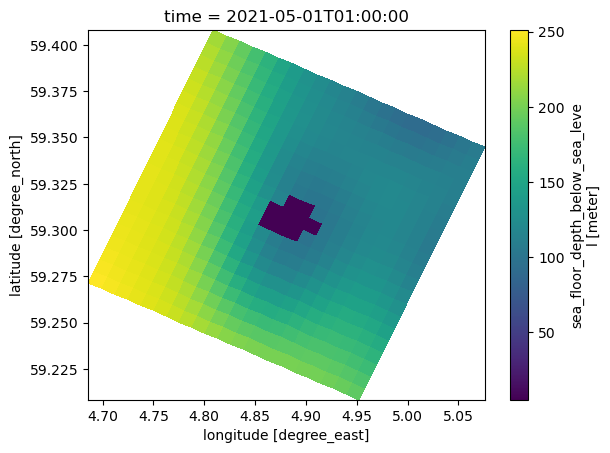

In [153]:
# Plot h at selected time (uses time_idx defined elsewhere)
h_da = data_5['h']
time_idx = 1
h_da = h_da.where(h_da >= 0, np.nan)
if 'time' in h_da.dims:
    h_da.isel(time=time_idx).plot.pcolormesh(x='lon', y='lat')
else:
    h_da.plot.pcolormesh(x='lon', y='lat')

## Eddies?


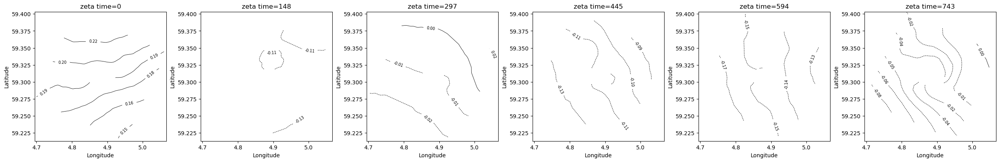

In [154]:
# Higher-resolution contour plots of sea surface height (zeta) at selected times
if 'zeta' in data_5.data_vars:
    zeta = data_5['zeta'].where(np.isfinite(data_5['zeta']))
    n_times = zeta.sizes.get('time', 0)
    if n_times == 0:
        print("zeta has no time dimension.")
    else:
        n_panels = min(6, n_times)
        idxs = np.linspace(0, n_times - 1, n_panels, dtype=int)

        # Refinement factor for X,Y grid
        ref_factor = 4  # increase for more interpolation refinement
        new_X = np.linspace(zeta.X.min(), zeta.X.max(), ref_factor * zeta.sizes['X'])
        new_Y = np.linspace(zeta.Y.min(), zeta.Y.max(), ref_factor * zeta.sizes['Y'])

        # Determine contour levels (broader range, more levels)
        z_sel = zeta.isel(time=idxs)
        vmin = float(z_sel.quantile(0.02))
        vmax = float(z_sel.quantile(0.98))
        levels = np.linspace(vmin, vmax, 30)

        fig, axes = plt.subplots(1, n_panels, figsize=(4.2 * n_panels, 4), constrained_layout=True)
        if n_panels == 1:
            axes = [axes]

        for ax, ti in zip(axes, idxs):
            z_fine = zeta.isel(time=ti).interp(X=new_X, Y=new_Y)
            cs = ax.contour(
                z_fine['lon'], z_fine['lat'], z_fine.values,
                levels=levels, colors='k', linewidths=0.6
            )
            ax.clabel(cs, fmt="%.2f", fontsize=7)
            ax.set_title(f'zeta time={ti}')
            ax.set_xlabel('Longitude')
            ax.set_ylabel('Latitude')

        plt.show()
else:
    print("Variable 'zeta' not found in data_5.")

<Figure size 700x600 with 0 Axes>

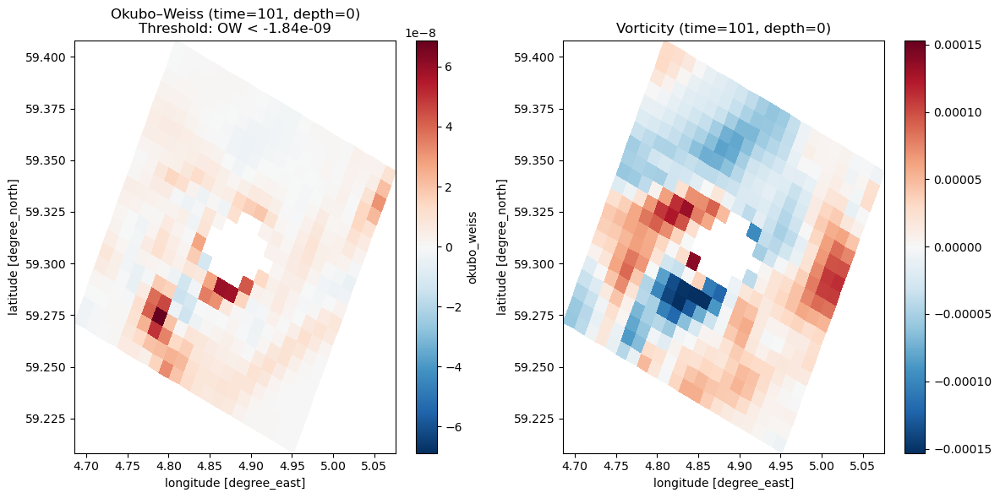

In [155]:
# Okubo–Weiss criterion at surface for selected time (uses existing time_idx)
depth_idx = 0  # surface layer index used earlier
time_idx = 101   # time index used earlier
u = data_5['u_eastward'].isel(time=time_idx, depth=depth_idx)
v = data_5['v_northward'].isel(time=time_idx, depth=depth_idx)

# Spatial derivatives
du_dx = u.differentiate('X')
dv_dy = v.differentiate('Y')
du_dy = u.differentiate('Y')
dv_dx = v.differentiate('X')

# Strain and vorticity components
s_n = du_dx - dv_dy          # normal strain
s_s = du_dy + dv_dx          # shear strain
omega = dv_dx - du_dy        # vertical vorticity

# Okubo–Weiss parameter
OW = s_n**2 + s_s**2 - omega**2
OW.name = 'okubo_weiss'

# Threshold for rotation-dominated (eddy candidate) regions
ow_thresh = -0.2 * OW.std().item()

plt.figure(figsize=(7, 6))
OW.plot(x='lon', y='lat', cmap='RdBu_r')
plt.title(f'Okubo–Weiss (time={int(time_idx)}, depth={depth_idx})\nThreshold: OW < {ow_thresh:.2e}')
plt.contour(OW['lon'], OW['lat'], OW.where(OW < ow_thresh), levels=[ow_thresh], colors='k', linewidths=0.8)
plt.clf()
fig, axes = plt.subplots(1, 2, figsize=(12, 6))

# Okubo–Weiss
OW.plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[0])
axes[0].set_title(f'Okubo–Weiss (time={int(time_idx)}, depth={depth_idx})\nThreshold: OW < {ow_thresh:.2e}')
axes[0].contour(OW['lon'], OW['lat'], OW.where(OW < ow_thresh), levels=[ow_thresh], colors='k', linewidths=0.8)

# Vorticity
omega.plot(x='lon', y='lat', cmap='RdBu_r', ax=axes[1])
axes[1].set_title(f'Vorticity (time={int(time_idx)}, depth={depth_idx})')

plt.tight_layout()
plt.show()

## Helmholtz–Hodge decomposition

Helmholtz–Hodge decomposition (time_idx=101, depth_idx=1)
Energy % -> Irrotational: 14.90  Solenoidal: 8.14  Harmonic: 104.24


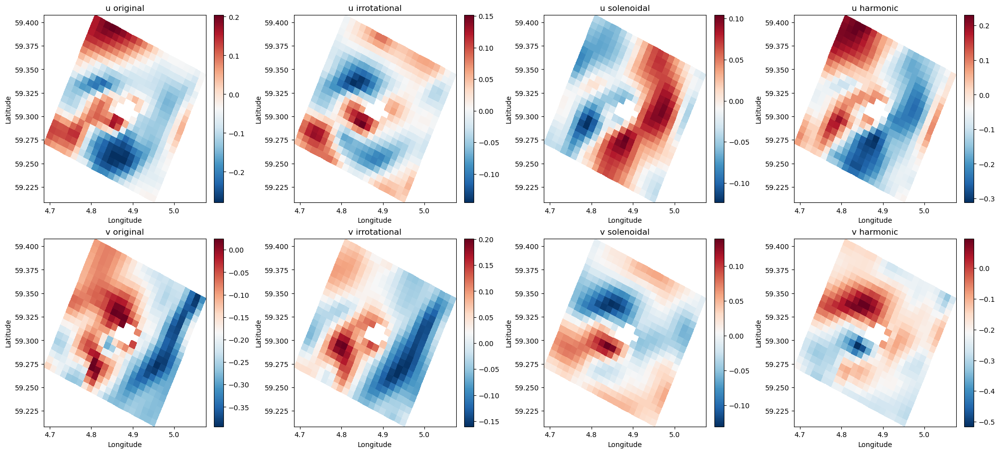

<xarray.Dataset> Size: 43kB
Dimensions:         (Y: 21, X: 21)
Coordinates:
  * X               (X) float64 168B 2.144e+05 2.152e+05 ... 2.296e+05 2.304e+05
    depth           float64 8B 3.0
    time            datetime64[ns] 8B 2021-05-05T05:00:00
  * Y               (Y) float64 168B 3.984e+05 3.992e+05 ... 4.136e+05 4.144e+05
    lat             (Y, X) float64 4kB 59.21 59.22 59.23 ... 59.39 59.4 59.4
    lon             (Y, X) float64 4kB 4.949 4.955 4.96 ... 4.801 4.807 4.812
Data variables:
    u_original      (Y, X) float32 2kB -0.02899 -0.03684 ... 0.1584 0.1589
    v_original      (Y, X) float32 2kB -0.264 -0.2705 ... -0.1003 -0.0976
    u_irrotational  (Y, X) float64 4kB 0.03615 0.04491 ... -0.0008699 -0.001421
    v_irrotational  (Y, X) float64 4kB -0.01286 -0.008964 ... 0.06956 0.0585
    u_solenoidal    (Y, X) float64 4kB -0.03499 -0.03907 ... -0.05078 -0.04319
    v_solenoidal    (Y, X) float64 4kB 0.021 0.02847 ... -0.004567 -0.007534
    u_harmonic      (Y, X) float64 4kB -0.03015 -0.04267 ... 0.2101 0.2035
    v_harmonic      (Y, X) float64 4kB -0.2721 -0.29 -0.2864 ... -0.1653 -0.1486
    divergence      (Y, X) float32 2kB -1.79e-05 -1.813e-05 ... -1.319e-05
    vorticity       (Y, X) float32 2kB -7.918e-06 3.347e-06 ... 2.914e-05
    phi             (Y, X) float64 4kB 154.4 183.3 226.2 ... 124.2 124.0 122.8
    psi             (Y, X) float64 4kB -23.4 -40.2 -68.95 ... -2.503 3.524

In [158]:
# Helmholtz–Hodge decomposition (surface layer) for a selected time index
try:
    time_idx
except NameError:
    time_idx = 1

depth_idx = 1

u = data_5['u_eastward'].isel(time=time_idx, depth=depth_idx)
v = data_5['v_northward'].isel(time=time_idx, depth=depth_idx)

mask = np.isnan(u.values) | np.isnan(v.values)
u_f = np.where(mask, 0.0, u.values)
v_f = np.where(mask, 0.0, v.values)

x = u['X'].values
y = u['Y'].values
dx = float(np.mean(np.diff(x)))
dy = float(np.mean(np.diff(y)))

du_dx = np.gradient(u_f, dx, axis=1)
dv_dy = np.gradient(v_f, dy, axis=0)
dv_dx = np.gradient(v_f, dx, axis=1)
du_dy = np.gradient(u_f, dy, axis=0)

div = du_dx + dv_dy
curl = dv_dx - du_dy

ny, nx = div.shape
kx = np.fft.fftfreq(nx, d=dx) * 2 * np.pi
ky = np.fft.fftfreq(ny, d=dy) * 2 * np.pi
KX, KY = np.meshgrid(kx, ky)
k2 = KX**2 + KY**2
k2[0, 0] = 1.0

div_k = np.fft.fft2(div)
curl_k = np.fft.fft2(curl)

phi_k = -div_k / k2
psi_k = -curl_k / k2

phi_k[0, 0] = 0.0
psi_k[0, 0] = 0.0

phi = np.real(np.fft.ifft2(phi_k))
psi = np.real(np.fft.ifft2(psi_k))

dphi_dx = np.gradient(phi, dx, axis=1)
dphi_dy = np.gradient(phi, dy, axis=0)
dpsi_dx = np.gradient(psi, dx, axis=1)
dpsi_dy = np.gradient(psi, dy, axis=0)

u_irrot = dphi_dx
v_irrot = dphi_dy
u_sol = dpsi_dy
v_sol = -dpsi_dx

u_harm = u_f - (u_irrot + u_sol)
v_harm = v_f - (v_irrot + v_sol)

for arr in [u_irrot, v_irrot, u_sol, v_sol, u_harm, v_harm]:
    arr[mask] = np.nan

hh_ds = xr.Dataset(
    {
        'u_original': (('Y','X'), u.values),
        'v_original': (('Y','X'), v.values),
        'u_irrotational': (('Y','X'), u_irrot),
        'v_irrotational': (('Y','X'), v_irrot),
        'u_solenoidal': (('Y','X'), u_sol),
        'v_solenoidal': (('Y','X'), v_sol),
        'u_harmonic': (('Y','X'), u_harm),
        'v_harmonic': (('Y','X'), v_harm),
        'divergence': (('Y','X'), div),
        'vorticity': (('Y','X'), curl),
        'phi': (('Y','X'), phi),
        'psi': (('Y','X'), psi),
    },
    coords={'X': u['X'], 'Y': u['Y'], 'lat': u['lat'], 'lon': u['lon']}
)

def energy(a, b):
    return np.nansum(a**2 + b**2)

E_tot = energy(u_f, v_f)
E_irrot = energy(u_irrot, v_irrot) / E_tot * 100.0
E_sol = energy(u_sol, v_sol) / E_tot * 100.0
E_harm = energy(u_harm, v_harm) / E_tot * 100.0

print(f"Helmholtz–Hodge decomposition (time_idx={time_idx}, depth_idx={depth_idx})")
print(f"Energy % -> Irrotational: {E_irrot:.2f}  Solenoidal: {E_sol:.2f}  Harmonic: {E_harm:.2f}")

fig, axes = plt.subplots(2, 4, figsize=(20, 9), constrained_layout=True)
cm = 'RdBu_r'

im0 = axes[0,0].pcolormesh(u['lon'], u['lat'], u.values, cmap=cm, shading='auto')
axes[0,0].set_title('u original'); plt.colorbar(im0, ax=axes[0,0])

im1 = axes[0,1].pcolormesh(u['lon'], u['lat'], u_irrot, cmap=cm, shading='auto')
axes[0,1].set_title('u irrotational'); plt.colorbar(im1, ax=axes[0,1])

im2 = axes[0,2].pcolormesh(u['lon'], u['lat'], u_sol, cmap=cm, shading='auto')
axes[0,2].set_title('u solenoidal'); plt.colorbar(im2, ax=axes[0,2])

im6 = axes[0,3].pcolormesh(u['lon'], u['lat'], u_harm, cmap=cm, shading='auto')
axes[0,3].set_title('u harmonic'); plt.colorbar(im6, ax=axes[0,3])

im3 = axes[1,0].pcolormesh(v['lon'], v['lat'], v.values, cmap=cm, shading='auto')
axes[1,0].set_title('v original'); plt.colorbar(im3, ax=axes[1,0])

im4 = axes[1,1].pcolormesh(v['lon'], v['lat'], v_irrot, cmap=cm, shading='auto')
axes[1,1].set_title('v irrotational'); plt.colorbar(im4, ax=axes[1,1])

im5 = axes[1,2].pcolormesh(v['lon'], v['lat'], v_sol, cmap=cm, shading='auto')
axes[1,2].set_title('v solenoidal'); plt.colorbar(im5, ax=axes[1,2])

im7 = axes[1,3].pcolormesh(v['lon'], v['lat'], v_harm, cmap=cm, shading='auto')
axes[1,3].set_title('v harmonic'); plt.colorbar(im7, ax=axes[1,3])

for ax in axes.flat:
    ax.set_xlabel('Longitude'); ax.set_ylabel('Latitude')

plt.show()

hh_ds


## LCS



In [160]:

# Extract velocity fields from data for the time range used in FTLE computation
# Use the same parameters as in cell 30
if 'start_idx' not in locals():
    start_idx = 0
if 'tau_steps' not in locals():
    tau_steps = int(1.0 * 24 / 1.0)  # tau_days=1.0, dt_hours=1.0

depth_idx = 0  # Surface layer

# Build velocity sequence (time, Y, X)
u_seq = []
v_seq = []
for step in range(tau_steps + 1):
    t_idx = start_idx + step
    if t_idx >= len(data.time):
        break
    u_field = data['u'].isel(time=t_idx, depth=depth_idx).values
    v_field = data['v'].isel(time=t_idx, depth=depth_idx).values
    u_seq.append(np.where(np.isnan(u_field), 0, u_field))
    v_seq.append(np.where(np.isnan(v_field), 0, v_field))

u_seq = np.array(u_seq)
v_seq = np.array(v_seq)

# Identifiser land (hastighet alltid null over hele tidsserien)
u_zero = np.all(u_seq == 0, axis=0)  # (Y, X)
v_zero = np.all(v_seq == 0, axis=0)
land_mask = u_zero & v_zero

# Mask negative FTLE + land
ftle_forward_pos = np.where((ftle_forward > 0) & ~land_mask, ftle_forward, np.nan)
ftle_backward_pos = np.where((ftle_backward > 0) & ~land_mask, ftle_backward, np.nan)

# Ridge extraction on positive FTLE
ridge_fwd, fwd_smooth, thr_fwd = extract_ridges(ftle_forward_pos, smooth_sigma=1.0, max_size=3, q=0.90)
ridge_bwd, bwd_smooth, thr_bwd = extract_ridges(ftle_backward_pos, smooth_sigma=1.0, max_size=3, q=0.90)

# Plot
fig, axes = plt.subplots(1, 2, figsize=(13, 5))

# Forward FTLE
im0 = axes[0].pcolormesh(lon, lat, ftle_forward_pos, shading='auto', cmap='plasma')
if ridge_fwd is not None and ridge_fwd.any():
    axes[0].contour(lon, lat, ridge_fwd, levels=[0.5], colors='white', linewidths=1.2)
# Marker land med grå kontur
axes[0].contour(lon, lat, land_mask, levels=[0.5], colors='gray', linewidths=1.5, linestyles='--')
axes[0].set_title(f'Forward FTLE (positive, τ≈{tau_days:.1f} d, thr={thr_fwd:.2e} s⁻¹)')
plt.colorbar(im0, ax=axes[0], label='FTLE (1/s)')

# Backward FTLE
im1 = axes[1].pcolormesh(lon, lat, ftle_backward_pos, shading='auto', cmap='plasma')
if ridge_bwd is not None and ridge_bwd.any():
    axes[1].contour(lon, lat, ridge_bwd, levels=[0.5], colors='white', linewidths=1.2)
axes[1].contour(lon, lat, land_mask, levels=[0.5], colors='gray', linewidths=1.5, linestyles='--')
axes[1].set_title(f'Backward FTLE (positive, τ≈{tau_days:.1f} d, thr={thr_bwd:.2e} s⁻¹)')
plt.colorbar(im1, ax=axes[1], label='FTLE (1/s)')

for ax in axes:
    ax.set_xlabel('Longitude')
    ax.set_ylabel('Latitude')
plt.tight_layout()
plt.show()

# Diagnostikk
neg_fwd = np.isfinite(ftle_forward) & (ftle_forward <= 0)
neg_bwd = np.isfinite(ftle_backward) & (ftle_backward <= 0)
print(f"Forward: {neg_fwd.sum()} negative ({100*neg_fwd.sum()/np.isfinite(ftle_forward).sum():.1f}%)")
print(f"Backward: {neg_bwd.sum()} negative ({100*neg_bwd.sum()/np.isfinite(ftle_backward).sum():.1f}%)")
print(f"Land mask: {land_mask.sum()} piksler ({100*land_mask.sum()/land_mask.size:.1f}%)")


NameError: name 'extract_ridges' is not defined

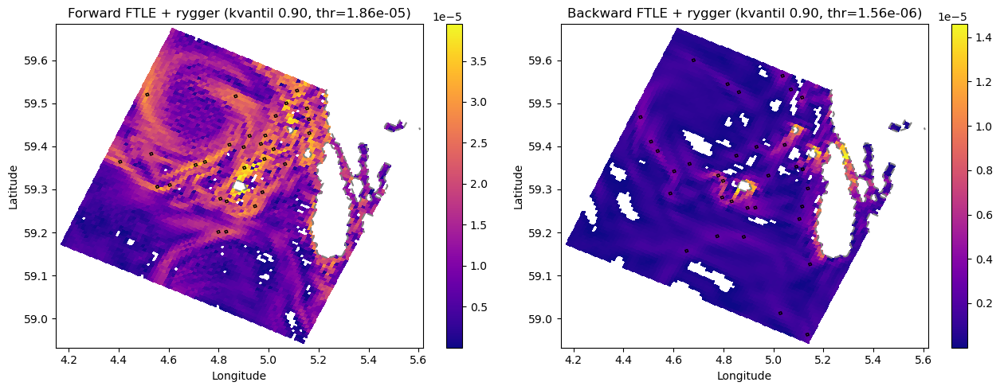

Forward kvantil 0.85: terskel=1.841e-05, antall piksler=33
Forward kvantil 0.9: terskel=2.020e-05, antall piksler=28
Forward kvantil 0.95: terskel=2.227e-05, antall piksler=19


In [161]:
# ...existing code...
from scipy.ndimage import gaussian_filter, maximum_filter
try:
    from skimage.morphology import skeletonize
except ImportError:
    skeletonize = None  # skimage ikke tilgjengelig

def extract_ridges(ftle, smooth_sigma=1.0, max_size=3, q=0.90):
    """
    Robust ridge extraction that tolerates empty or all-NaN input.
    Returns (ridge_mask, smoothed_field, threshold).
    """
    if ftle is None:
        return None, None, np.nan
    f = np.array(ftle, copy=True)
    # Replace NaNs with very low value so they are ignored but keep size
    f[~np.isfinite(f)] = -1e9
    # If everything is filler, abort early
    if np.all(f <= -1e8):
        ridge = np.zeros_like(f, dtype=bool)
        return ridge, f, np.nan
    f_s = gaussian_filter(f, sigma=smooth_sigma)
    # Local maxima
    loc_max = (f_s == maximum_filter(f_s, size=max_size))
    # Finite valid values
    finite_vals = f_s[np.isfinite(f_s)]
    if finite_vals.size == 0:
        ridge = np.zeros_like(f_s, dtype=bool)
        return ridge, f_s, np.nan
    # Quantile threshold (clip q to [0,1])
    q = min(max(q, 0.0), 1.0)
    try:
        thr = np.quantile(finite_vals, q)
    except Exception:
        thr = np.nan
    if np.isnan(thr):
        ridge = np.zeros_like(f_s, dtype=bool)
        return ridge, f_s, thr
    ridge = loc_max & (f_s >= thr)
    # Optional thinning
    if skeletonize is not None and ridge.any():
        try:
            ridge = skeletonize(ridge)
        except Exception:
            pass
    return ridge, f_s, thr

ridge_fwd, fwd_smooth, thr_fwd = extract_ridges(ftle_forward, smooth_sigma=1.0, max_size=3, q=0.90)
ridge_bwd, bwd_smooth, thr_bwd = extract_ridges(ftle_backward, smooth_sigma=1.0, max_size=3, q=0.90)
# Mask out land (island) from the FTLE fields before ridge extraction
ftle_forward_masked = np.where(~land_mask, ftle_forward, np.nan)
ftle_backward_masked = np.where(~land_mask, ftle_backward, np.nan)

ridge_fwd, fwd_smooth, thr_fwd = extract_ridges(ftle_forward_masked, smooth_sigma=1.0, max_size=3, q=0.90)
ridge_bwd, bwd_smooth, thr_bwd = extract_ridges(ftle_backward_masked, smooth_sigma=1.0, max_size=3, q=0.90)
fig, axes = plt.subplots(1,2, figsize=(13,5))
# Masker ut øya og bare positive verdier
ftle_forward_pos = np.where((ftle_forward > 0) & ~land_mask, ftle_forward, np.nan)
im0 = axes[0].pcolormesh(lon, lat, ftle_forward_pos, shading='auto', cmap='plasma')
# Vis konturene av øya
axes[0].contour(lon, lat, land_mask, levels=[0.5], colors='gray', linewidths=1.5, linestyles='--')
if ridge_fwd is not None and ridge_fwd.any():
    # Mask out ridges on land before plotting
    ridge_fwd_masked = ridge_fwd & ~land_mask
    if ridge_fwd_masked.any():
        axes[0].contour(lon, lat, ridge_fwd_masked, levels=[0.5], colors='k', linewidths=1.0)
axes[0].set_title(f'Forward FTLE + rygger (kvantil 0.90, thr={thr_fwd if np.isfinite(thr_fwd) else float("nan"):.2e})')
plt.colorbar(im0, ax=axes[0])

# Masker ut øya og bare positive verdier
ftle_backward_pos = np.where((ftle_backward > 0) & ~land_mask, ftle_backward, np.nan)
im1 = axes[1].pcolormesh(lon, lat, ftle_backward_pos, shading='auto', cmap='plasma')
# Vis konturene av øya
axes[1].contour(lon, lat, land_mask, levels=[0.5], colors='gray', linewidths=1.5, linestyles='--')
if ridge_bwd is not None and ridge_bwd.any():
    axes[1].contour(lon, lat, ridge_bwd, levels=[0.5], colors='k', linewidths=1.0)
axes[1].set_title(f'Backward FTLE + rygger (kvantil 0.90, thr={thr_bwd if np.isfinite(thr_bwd) else float("nan"):.2e})')
plt.colorbar(im1, ax=axes[1])

for ax in axes:
    ax.set_xlabel('Longitude'); ax.set_ylabel('Latitude')
plt.tight_layout()
plt.show()

# Alternativ: Juster kvantil
for q in [0.85, 0.90, 0.95]:
    r, _, thr = extract_ridges(ftle_forward, q=q)
    if r is None or np.isnan(thr):
        print(f'Forward kvantil {q}: ingen gyldige piksler')
    else:
        print(f'Forward kvantil {q}: terskel={thr:.3e}, antall piksler={int(r.sum())}')
# ...existing code...

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3795504644.py:43: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(lon_grid, lat_grid, u_field, levels=[0], colors='b', linewidths=2.2, linestyles='--', label='u=0')
/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3795504644.py:44: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(lon_grid, lat_grid, v_field, levels=[0], colors='g', linewidths=2.2, linestyles='-.', label='v=0')
/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3795504644.py:65: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(lon_grid, lat_grid, land_mask, levels=[0.5], colors='gray', linewidths=2.5, linestyles='--', label='Land')
/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/3795504644.py:76: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contourf(lon_grid, lat_grid, fwd_high.astyp

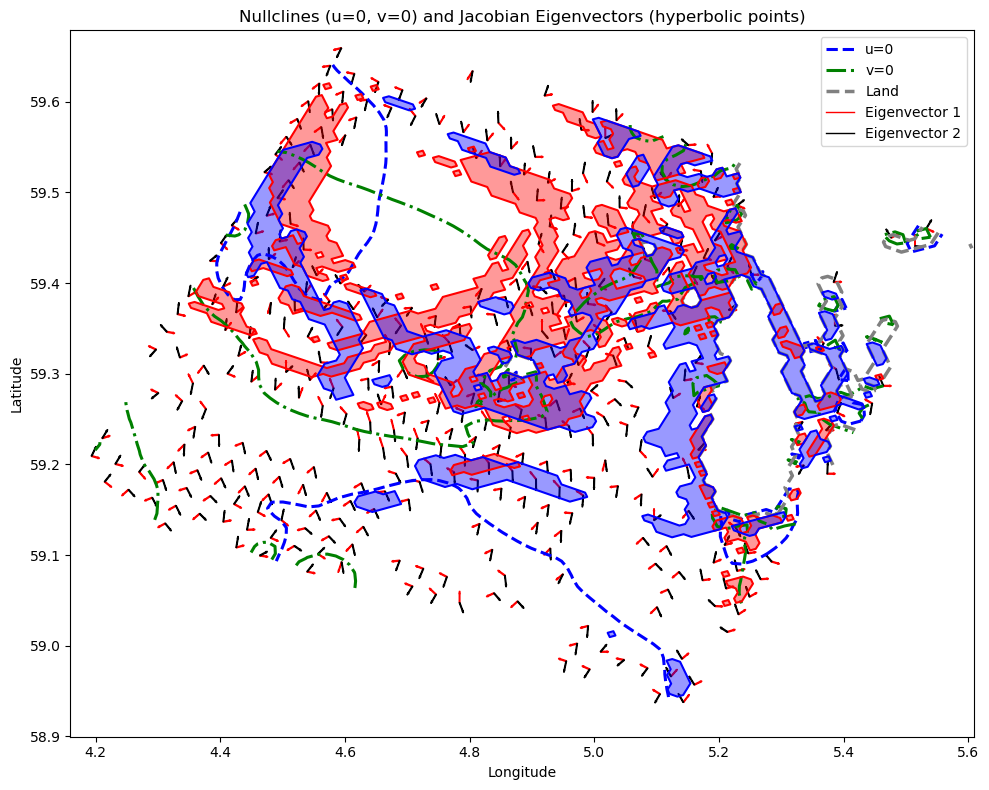

In [162]:
from matplotlib.lines import Line2D

import matplotlib.pyplot as plt

# Compute the Jacobian of the flow field at each grid point for a selected time index
# Use u_seq and v_seq from previous cells (shape: T, NY, NX)
# We'll use the backward FTLE final positions (xb, yb) as the grid for analysis

# Select a time index for visualization (e.g., start_idx used in FTLE calculation)
t_idx = start_idx if 'start_idx' in locals() else 0

# Use velocity field at t_idx
u_field = u_seq[t_idx]
v_field = v_seq[t_idx]

# Compute gradients (Jacobian components) at each grid point
du_dx = np.gradient(u_field, axis=1)
du_dy = np.gradient(u_field, axis=0)
dv_dx = np.gradient(v_field, axis=1)
dv_dy = np.gradient(v_field, axis=0)

NY, NX = u_field.shape
skip = max(NY // 20, 1)  # skip for quiver plot

# Prepare grid for plotting
lon_grid = lon
lat_grid = lat

# Compute eigenvalues and eigenvectors of the Jacobian at each grid point
eigvals = np.zeros((NY, NX, 2), dtype=np.complex128)
eigvecs = np.zeros((NY, NX, 2, 2), dtype=np.complex128)

for i in range(NY):
    for j in range(NX):
        J = np.array([[du_dx[i, j], du_dy[i, j]],
                      [dv_dx[i, j], dv_dy[i, j]]])
        vals, vecs = np.linalg.eig(J)
        eigvals[i, j] = vals
        eigvecs[i, j] = vecs

# Visualize nullclines (where u=0 or v=0) and eigenvectors at selected points
plt.figure(figsize=(10, 8))
plt.contour(lon_grid, lat_grid, u_field, levels=[0], colors='b', linewidths=2.2, linestyles='--', label='u=0')
plt.contour(lon_grid, lat_grid, v_field, levels=[0], colors='g', linewidths=2.2, linestyles='-.', label='v=0')

# Overlay eigenvectors at a subset of grid points
for i in range(0, NY, skip):
    for j in range(0, NX, skip):
        # Only plot if both eigenvalues are real and have opposite sign (hyperbolic)
        vals = eigvals[i, j]
        vecs = eigvecs[i, j]
        if np.all(np.isreal(vals)) and vals[0] * vals[1] < 0:
            # Normalize eigenvectors for plotting
            v1 = np.real(vecs[:, 0])
            v2 = np.real(vecs[:, 1])
            v1 /= np.linalg.norm(v1) + 1e-12
            v2 /= np.linalg.norm(v2) + 1e-12
            plt.arrow(lon_grid[i, j], lat_grid[i, j], v1[0]*0.01, v1[1]*0.01, color='r', head_width=0.002)
            plt.arrow(lon_grid[i, j], lat_grid[i, j], v2[0]*0.01, v2[1]*0.01, color='k', head_width=0.002)

plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.title('Nullclines (u=0, v=0) and Jacobian Eigenvectors (hyperbolic points)')
plt.tight_layout()
plt.contour(lon_grid, lat_grid, land_mask, levels=[0.5], colors='gray', linewidths=2.5, linestyles='--', label='Land')
# Create custom legend handles since contour labels may not auto-generate
# Overlay forward and backward FTLE maxima on the plot
# Find locations where forward FTLE is highest (repelling structures)
bnd=0.8
fwd_high = (ftle_forward_pos > np.nanquantile(ftle_forward_pos, bnd))
# Find locations where backward FTLE is highest (attracting structures)
bwd_high = (ftle_backward_pos > np.nanquantile(ftle_backward_pos, bnd))

# Plot these high FTLE regions with different colors
if fwd_high.any():
    plt.contourf(lon_grid, lat_grid, fwd_high.astype(float), levels=[0.5, 1.5], colors='red', alpha=0.4, label='High Forward FTLE')
    plt.contour(lon_grid, lat_grid, fwd_high.astype(float), levels=[0.5], colors='red', linewidths=1.5)
if bwd_high.any():
    plt.contourf(lon_grid, lat_grid, bwd_high.astype(float), levels=[0.5, 1.5], colors='blue', alpha=0.4, label='High Backward FTLE')
    plt.contour(lon_grid, lat_grid, bwd_high.astype(float), levels=[0.5], colors='blue', linewidths=1.5)
legend_elements = [
    Line2D([0], [0], color='b', linewidth=2.2, linestyle='--', label='u=0'),
    Line2D([0], [0], color='g', linewidth=2.2, linestyle='-.', label='v=0'),
    Line2D([0], [0], color='gray', linewidth=2.5, linestyle='--', label='Land'),
    Line2D([0], [0], color='r', linewidth=1, label='Eigenvector 1'),
    Line2D([0], [0], color='k', linewidth=1, label='Eigenvector 2')
]

plt.legend(handles=legend_elements, loc='best')
plt.show()


## U-v

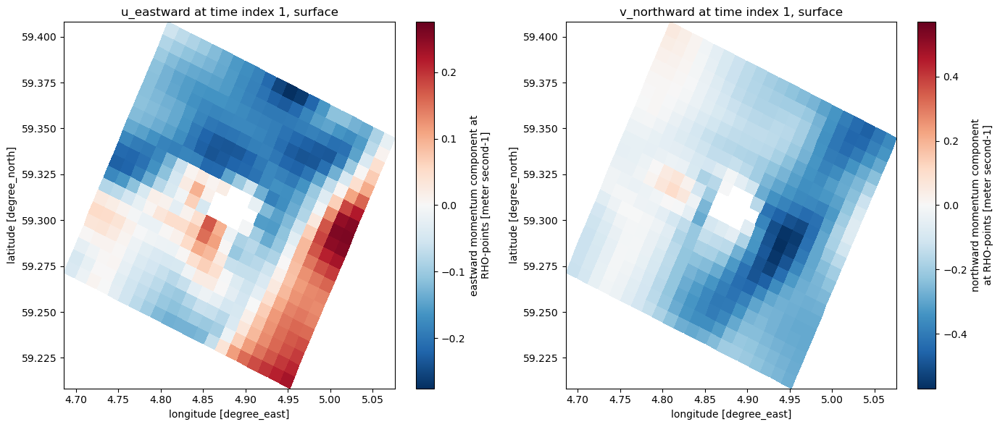

In [163]:
import matplotlib.pyplot as plt
# Calculate speed from u and v components
data_5['speed'] = np.sqrt(data_5['u_eastward']**2 + data_5['v_northward']**2)
# Select a time index (e.g., 0 for the first time step)
time_idx = 1

# Create figure with two subplots side by side
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot u_eastward
data_5['u_eastward'].isel(time=time_idx, depth=1).plot(x='lon', y='lat', ax=ax1, cmap='RdBu_r')
ax1.set_title(f'u_eastward at time index {time_idx}, surface')

# Plot v_northward
data_5['v_northward'].isel(time=time_idx, depth=1).plot(x='lon', y='lat', ax=ax2, cmap='RdBu_r')
ax2.set_title(f'v_northward at time index {time_idx}, surface')

plt.tight_layout()
plt.show()

In [166]:
# Rotate ubar and vbar to eastward and northward components
# Get the angle from the dataset
angle = data_5['angle']

# Calculate eastward and northward components of barotropic velocity
data_5['ubar_eastward'] = data_5['ubar'] * np.cos(angle) - data_5['vbar'] * np.sin(angle)
data_5['vbar_northward'] = data_5['ubar'] * np.sin(angle) + data_5['vbar'] * np.cos(angle)
# Calculate eastward and northward components of wind velocity
data_5['Uwind_eastward'] = data_5['Uwind'] * np.cos(angle) - data_5['Vwind'] * np.sin(angle)
data_5['Vwind_northward'] = data_5['Uwind'] * np.sin(angle) + data_5['Vwind'] * np.cos(angle)
print("Created ubar_eastward and vbar_northward from ubar, vbar, and angle")

Created ubar_eastward and vbar_northward from ubar, vbar, and angle


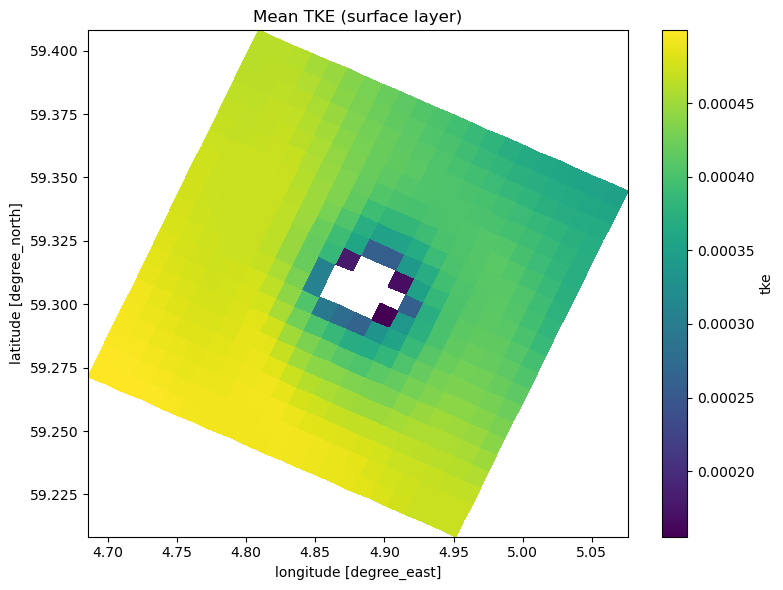

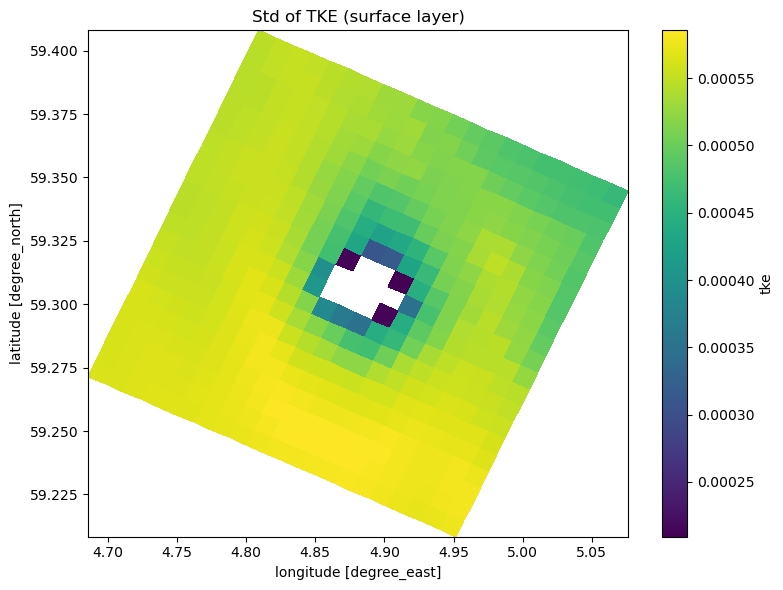

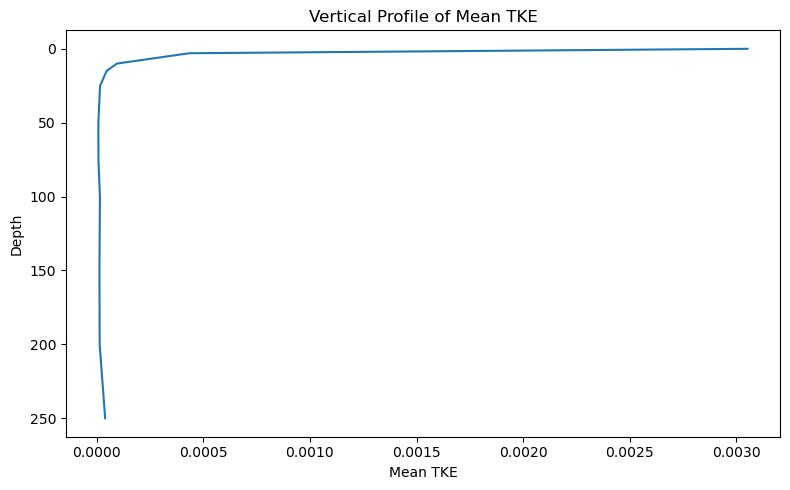

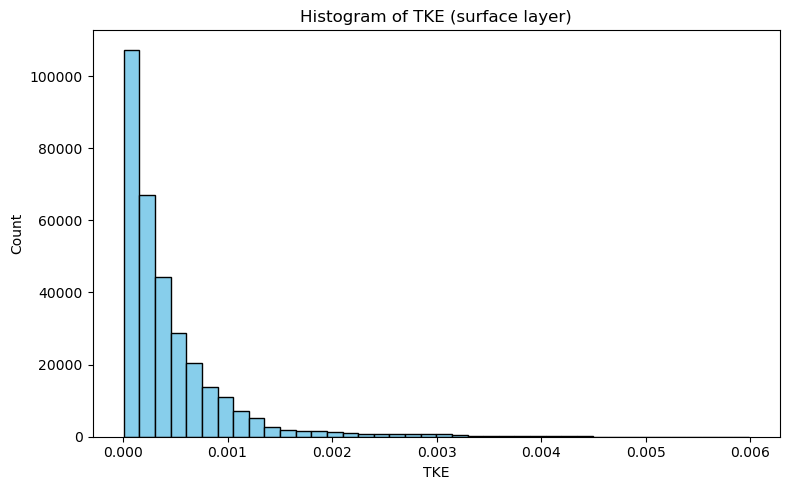

In [167]:
import numpy as np

import matplotlib.pyplot as plt

# Check if 'tke' exists in data_5
if 'tke' in data_5:
    tke = data_5['tke']
    # Mask missing values (>=1e36)
    tke = tke.where(tke < 1e36, np.nan)

    # 1. Plot mean TKE over time at surface layer
    plt.figure(figsize=(8, 6))
    tke.mean(dim='time').isel(depth=1).plot(x='lon', y='lat')
    plt.title('Mean TKE (surface layer)')
    plt.tight_layout()
    plt.show()

    # 2. Plot standard deviation of TKE over time at surface layer
    plt.figure(figsize=(8, 6))
    tke.std(dim='time').isel(depth=1).plot(x='lon', y='lat')
    plt.title('Std of TKE (surface layer)')
    plt.tight_layout()
    plt.show()

    # 3. Plot vertical profile of mean TKE (spatial average)
    mean_tke_profile = tke.mean(dim=['time', 'Y', 'X'])
    plt.figure(figsize=(8, 5))
    plt.plot(mean_tke_profile, tke['depth'])
    plt.gca().invert_yaxis()
    plt.xlabel('Mean TKE')
    plt.ylabel('Depth')
    plt.title('Vertical Profile of Mean TKE')
    plt.tight_layout()
    plt.show()

    # 4. Histogram of TKE values (surface layer, all times and locations)
    tke_surface = tke.isel(depth=1).values.flatten()
    tke_surface = tke_surface[(~np.isnan(tke_surface)) & (tke_surface < 1e36)]
    plt.figure(figsize=(8, 5))
    plt.hist(tke_surface, bins=40, color='skyblue', edgecolor='k')
    plt.xlabel('TKE')
    plt.ylabel('Count')
    plt.title('Histogram of TKE (surface layer)')
    plt.tight_layout()
    plt.show()
else:
    print("Variable 'tke' not found in data_5.")

In [168]:
data_5['tke']=data_5['tke'].where(data_5['tke'] < 1e36, np.nan)

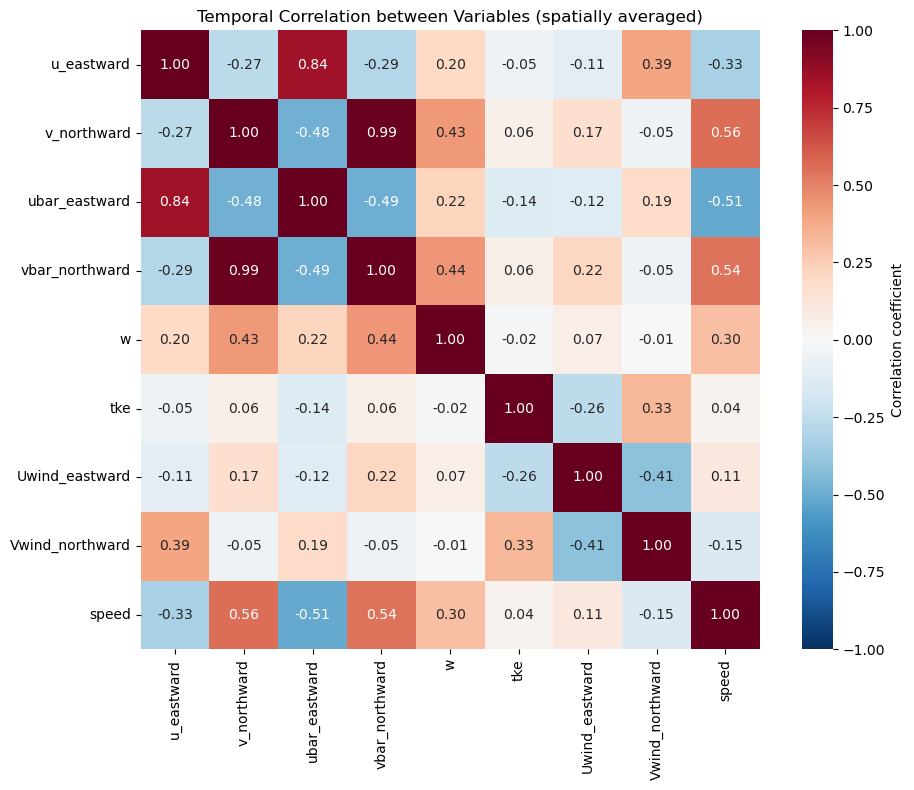

In [169]:
import numpy as np
import seaborn as sns

# Calculate correlation between different variables in data_5 over time
import matplotlib.pyplot as plt

# Select variables to correlate (excluding coordinates and metadata)
vars_to_correlate = ['u_eastward', 'v_northward', 'ubar_eastward', 'vbar_northward', 'w', 'tke', 'Uwind_eastward', 'Vwind_northward','speed']

# Filter only variables that exist in the dataset
available_vars = [v for v in vars_to_correlate if v in data_5.data_vars]

# Flatten each variable to (time, space) and compute temporal correlation
correlation_matrix = np.zeros((len(available_vars), len(available_vars)))

for i, var1 in enumerate(available_vars):
    data1 = data_5[var1].values
    # Flatten spatial dimensions, keep time as first dimension
    flat1 = data1.reshape(data1.shape[0], -1)  # (time, space)
    # Average over space for each time step
    time_series1 = np.nanmean(flat1, axis=1)
    
    for j, var2 in enumerate(available_vars):
        data2 = data_5[var2].values
        flat2 = data2.reshape(data2.shape[0], -1)
        time_series2 = np.nanmean(flat2, axis=1)
        
        # Compute correlation coefficient
        valid_mask = ~(np.isnan(time_series1) | np.isnan(time_series2))
        if np.sum(valid_mask) > 1:
            correlation_matrix[i, j] = np.corrcoef(time_series1[valid_mask], 
                                                     time_series2[valid_mask])[0, 1]
        else:
            correlation_matrix[i, j] = np.nan

# Plot heatmap
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, 
            xticklabels=available_vars, 
            yticklabels=available_vars,
            annot=True, 
            fmt='.2f', 
            cmap='RdBu_r', 
            vmin=-1, 
            vmax=1,
            center=0,
            square=True,
            cbar_kws={'label': 'Correlation coefficient'})
plt.title('Temporal Correlation between Variables (spatially averaged)')
plt.tight_layout()
plt.show()

## SVD surface only

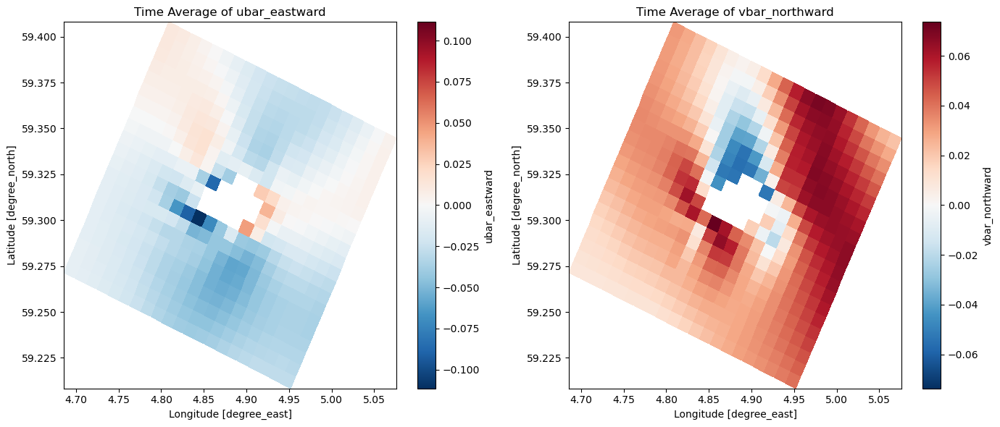

In [171]:
# Compute time averages for ubar_eastward and vbar_northward
ubar_avg = data_5['ubar_eastward'].mean(dim='time')
vbar_avg = data_5['vbar_northward'].mean(dim='time')

# Plot mean ubar and vbar
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 6))

# Plot mean ubar_eastward
ubar_avg.plot(ax=ax1, x='lon', y='lat', cmap='RdBu_r')
ax1.set_title('Time Average of ubar_eastward')
ax1.set_xlabel('Longitude [degree_east]')
ax1.set_ylabel('Latitude [degree_north]')

# Plot mean vbar_northward
vbar_avg.plot(ax=ax2, x='lon', y='lat', cmap='RdBu_r')
ax2.set_title('Time Average of vbar_northward')
ax2.set_xlabel('Longitude [degree_east]')
ax2.set_ylabel('Latitude [degree_north]')

plt.tight_layout()
plt.show()

In [172]:
# Create a new dataset with only surface values for selected variables plus ubar values
data_surface = data_5[['ubar_eastward', 'vbar_northward']].copy()#, 'Uwind_eastward', 'Vwind_northward']].copy()

# Add surface layer (depth index 0 or 1) for 3D variables
data_surface['u_eastward'] = data_5['u_eastward'].isel(depth=1)
data_surface['v_northward'] = data_5['v_northward'].isel(depth=1)
data_surface['tke'] = data_5['tke'].isel(depth=1)

# Add speed at surface if it exists
if 'speed' in data_5:
    data_surface['speed'] = data_5['speed'].isel(depth=1)

print("Surface dataset created with variables:", list(data_surface.data_vars))
print("Dataset shape:", data_surface.dims)

Surface dataset created with variables: ['ubar_eastward', 'vbar_northward', 'u_eastward', 'v_northward', 'tke', 'speed']
Dataset shape: FrozenMappingWarningOnValuesAccess({'time': 744, 'Y': 21, 'X': 21})


In [173]:
data_surface

<xarray.Dataset> Size: 11MB
Dimensions:         (time: 744, Y: 21, X: 21)
Coordinates:
  * X               (X) float64 168B 2.144e+05 2.152e+05 ... 2.296e+05 2.304e+05
  * Y               (Y) float64 168B 3.984e+05 3.992e+05 ... 4.136e+05 4.144e+05
  * time            (time) datetime64[ns] 6kB 2021-05-01 ... 2021-05-31T23:00:00
    lat             (Y, X) float64 4kB 59.21 59.22 59.23 ... 59.39 59.4 59.4
    lon             (Y, X) float64 4kB 4.949 4.955 4.96 ... 4.801 4.807 4.812
    depth           float64 8B 3.0
Data variables:
    ubar_eastward   (time, Y, X) float64 3MB 0.01799 0.01991 ... 0.02732 0.04209
    vbar_northward  (time, Y, X) float64 3MB -0.03491 -0.03947 ... 0.1558 0.1449
    u_eastward      (time, Y, X) float32 1MB 0.2538 0.2459 ... -0.08206 -0.01557
    v_northward     (time, Y, X) float32 1MB -0.1526 -0.1635 ... 0.2997 0.3005
    tke             (time, Y, X) float32 1MB 7.6e-06 7.6e-06 ... 0.0002167
    speed           (time, Y, X) float32 1MB 0.2962 0.2953 ... 0.3107 0.3009
Attributes: (12/33)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    his_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    history:                         Sat May  1 16:41:01 2021: ncks -O --4 -d...
    ana_file:                        ROMS/Functionals/ana_btflux.h, ROMS/Func...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    Conventions:                     CF-1.4, SGRID-0.3
    NCO:                             netCDF Operators version 4.8.0 (Homepage...
    DODS_EXTRA.Unlimited_Dimension:  time

In [174]:
# SVD of data_surface (EOF analysis)
# Uses variables present in data_surface (expects dims: time, Y, X)

# Select variables with a time dimension
svd_vars = [v for v in data_surface.data_vars if 'time' in data_surface[v].dims]

# Build (time, combined_space) matrix
flat_list = []
sizes = []
for v in svd_vars:
    da = data_surface[v].transpose('time', 'Y', 'X')
    arr = da.values.reshape(da.shape[0], -1)  # (time, space_v)
    flat_list.append(arr)
    sizes.append(arr.shape[1])

combined_time_space = np.concatenate(flat_list, axis=1)  # (time, total_space)

# Remove temporal mean (per spatial point)
space_mean = np.nanmean(combined_time_space, axis=0, keepdims=True)  # (1, space)
anomalies = combined_time_space - space_mean

# Fill NaNs with 0 before SVD
A = np.nan_to_num(anomalies).T  # (space, time)

# SVD
U_surf, S_surf, Vt_surf = np.linalg.svd(A, full_matrices=False)
var_explained_surf = (S_surf**2 / np.sum(S_surf**2)) * 100.0

# Package results
surface_svd_results = {
    'vars': svd_vars,
    'U': U_surf,
    'S': S_surf,
    'Vt': Vt_surf,
    'variance_explained_percent': var_explained_surf,
    'space_points': A.shape[0],
    'time_points': A.shape[1],
    'segment_sizes': dict(zip(svd_vars, sizes))
}

# Print quick summary
print(f"SVD complete: space={A.shape[0]}, time={A.shape[1]}")
print("Variables:", svd_vars)
print("First 5 variance explained (%):", np.round(var_explained_surf[:5], 2))

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/2302093797.py:19: RuntimeWarning: Mean of empty slice
  space_mean = np.nanmean(combined_time_space, axis=0, keepdims=True)  # (1, space)


SVD complete: space=2646, time=744
Variables: ['ubar_eastward', 'vbar_northward', 'u_eastward', 'v_northward', 'tke', 'speed']
First 5 variance explained (%): [58.91 10.51  5.14  4.4   2.36]


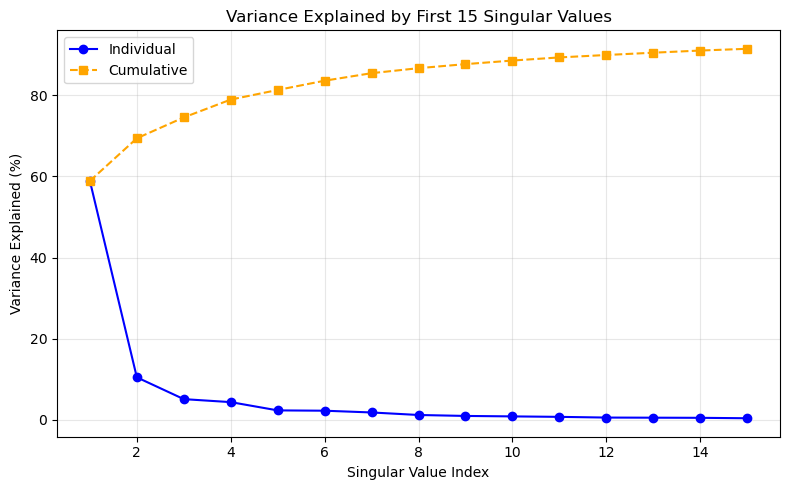

In [175]:
import matplotlib.pyplot as plt
# Calculate cumulative variance explained
cum_var_explained = np.cumsum(var_explained_surf[:15])

# Plot both individual and cumulative variance explained
plt.figure(figsize=(8, 5))
plt.plot(range(1, 16), var_explained_surf[:15], 'o-', color='blue', label='Individual')
plt.plot(range(1, 16), cum_var_explained, 's--', color='orange', label='Cumulative')
plt.xlabel('Singular Value Index')
plt.ylabel('Variance Explained (%)')
plt.title('Variance Explained by First 15 Singular Values')
plt.grid(True, alpha=0.3)
plt.legend()
plt.tight_layout()
plt.show()

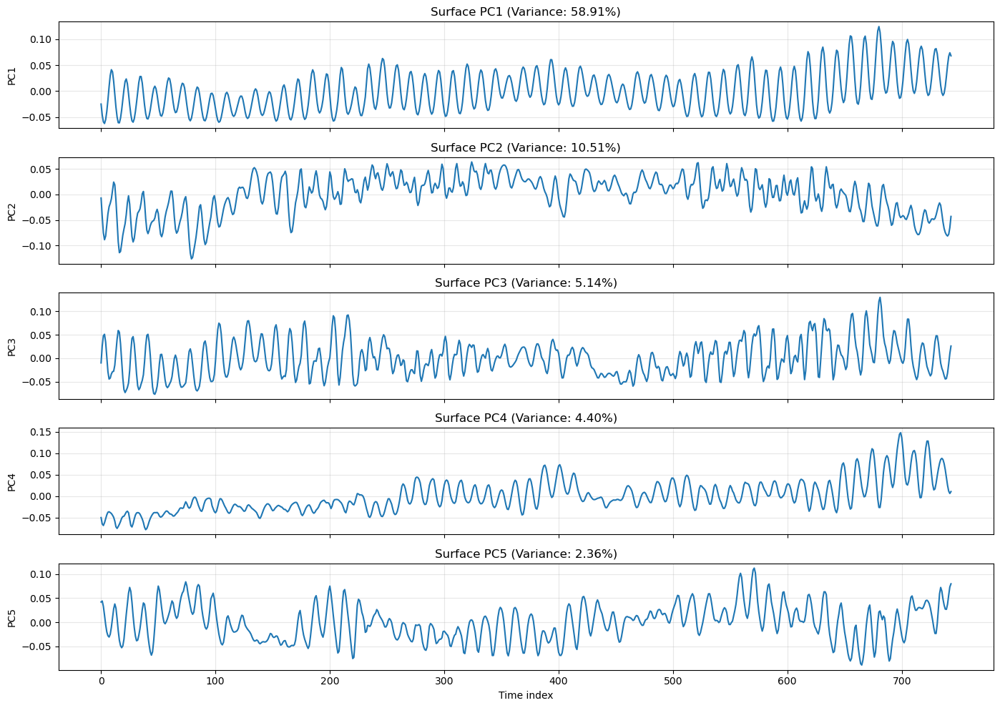

In [176]:
# Plot time series of principal components from surface SVD
import matplotlib.pyplot as plt

fig, axes = plt.subplots(5, 1, figsize=(14, 10), sharex=True)

for i in range(5):
    axes[i].plot(surface_svd_results['Vt'][i, :], linewidth=1.5)
    axes[i].set_ylabel(f'PC{i+1}')
    axes[i].set_title(f'Surface PC{i+1} (Variance: {surface_svd_results["variance_explained_percent"][i]:.2f}%)')
    axes[i].grid(True, alpha=0.3)

axes[-1].set_xlabel('Time index')
plt.tight_layout()
plt.show()

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/1924625472.py:14: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  if arr.shape[0] != data_5.dims['time']:


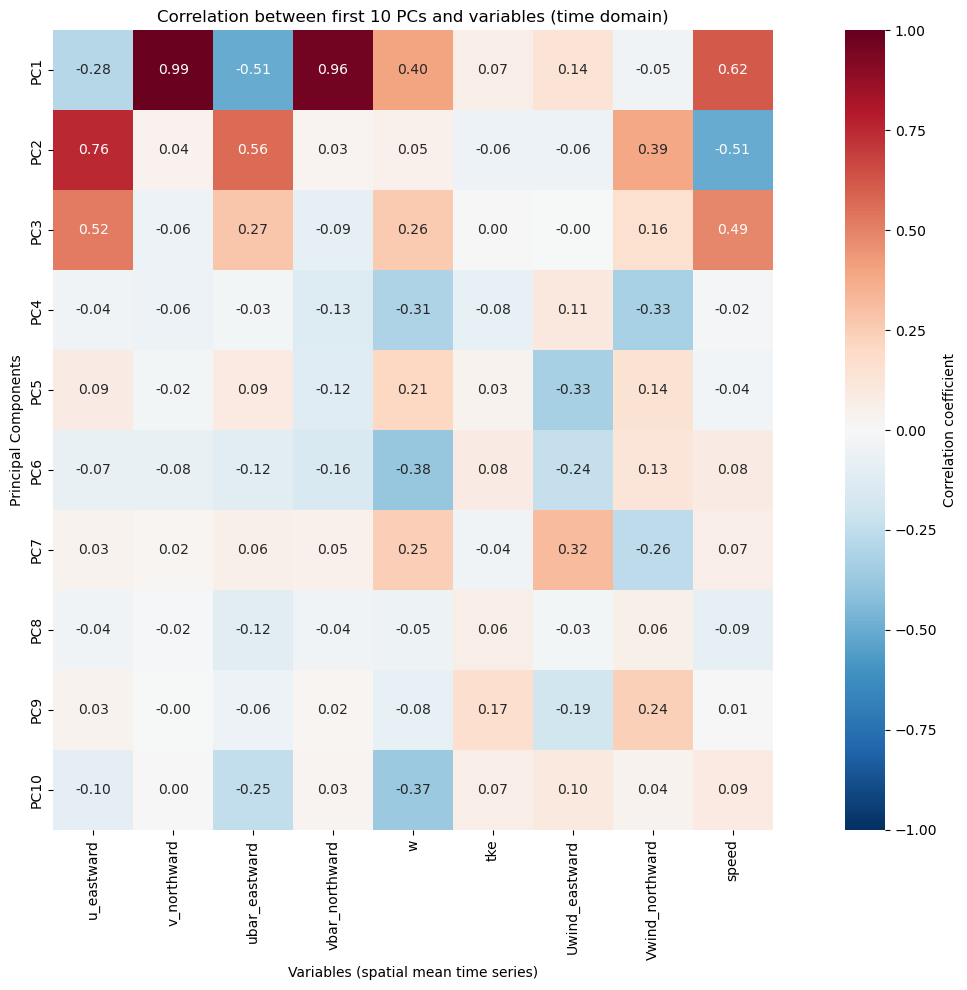

In [177]:
import seaborn as sns

# Prepare data for correlation heatmap between variables and first 10 PCs
# Use the first 10 PCs from Vt_all
n_pcs = min(10, Vt_surf.shape[0])
pcs = Vt_surf[:n_pcs, :]  # shape (n_pcs, time)

# Build variable time series (spatial mean over all non-NaN points)
vars_for_corr = [v for v in vars_to_correlate if v in data_5.data_vars]
var_series = []
for var in vars_for_corr:
    arr = data_5[var].values
    # Ensure time is first axis
    if arr.shape[0] != data_5.dims['time']:
        try:
            time_axis = list(data_5[var].dims).index('time')
            axes = [time_axis] + [i for i in range(arr.ndim) if i != time_axis]
            arr = np.transpose(arr, axes)
        except Exception:
            continue
    flat = arr.reshape(arr.shape[0], -1)  # (time, space)
    ts = np.nanmean(flat, axis=1)         # (time,)
    var_series.append(ts)

var_series = np.array(var_series)  # (n_vars, time)

# Correlation: PC vs variable across time
corr_matrix = np.zeros((n_pcs, len(vars_for_corr)))
for i in range(n_pcs):
    pc_ts = pcs[i]
    for j in range(len(vars_for_corr)):
        vs = var_series[j]
        mask = ~(np.isnan(pc_ts) | np.isnan(vs))
        if mask.sum() > 1:
            corr_matrix[i, j] = np.corrcoef(pc_ts[mask], vs[mask])[0, 1]
        else:
            corr_matrix[i, j] = np.nan

# Plot heatmap
plt.figure(figsize=(1.2 * len(vars_for_corr) + 4, 0.6 * n_pcs + 4))
sns.heatmap(corr_matrix,
            xticklabels=vars_for_corr,
            yticklabels=[f'PC{i+1}' for i in range(n_pcs)],
            annot=True, 
            fmt='.2f', 
            cmap='RdBu_r', 
            vmin=-1, 
            vmax=1,
            center=0,
            square=True,
            cbar_kws={'label': 'Correlation coefficient'})
plt.xlabel('Variables (spatial mean time series)')
plt.ylabel('Principal Components')
plt.title('Correlation between first 10 PCs and variables (time domain)')
plt.tight_layout()
plt.show()



/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/474321058.py:23: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  arr = arr.T.reshape(-1, data_surface.dims['Y'], data_surface.dims['X'])


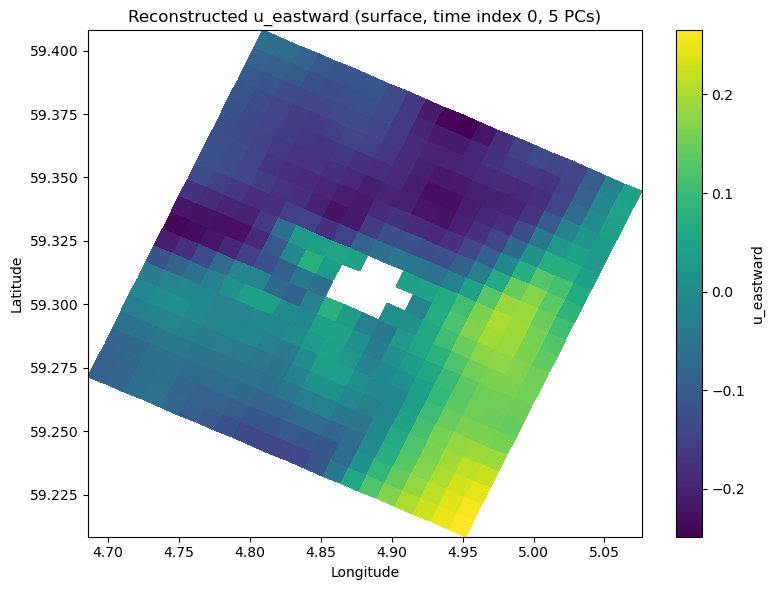

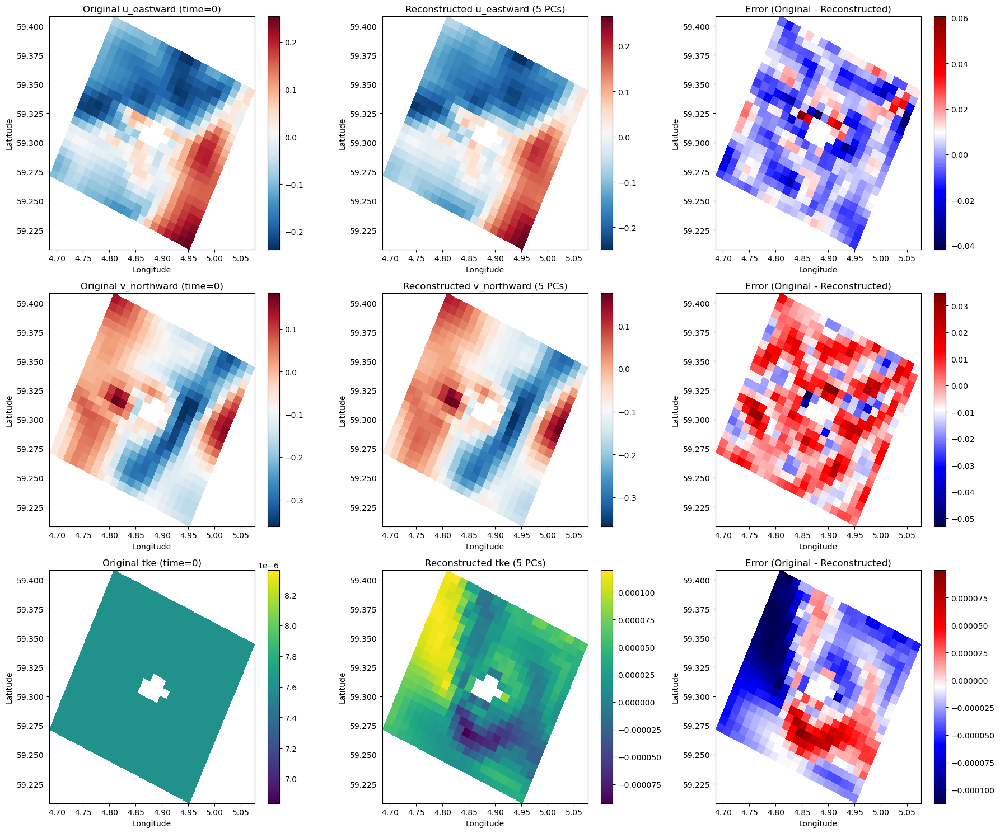

In [178]:
# Reconstruct the surface data using the first 5 principal components (PCs)
# Assume U_surf, S_surf, Vt_surf from surface SVD are available

n_pcs = 150
# Use only the first n_pcs components
U5 = U_surf[:, :n_pcs]           # (space, n_pcs)
S5 = S_surf[:n_pcs]              # (n_pcs,)
Vt5 = Vt_surf[:n_pcs, :]         # (n_pcs, time)

# Reconstruct anomalies (space, time)
A_recon = (U5 * S5) @ Vt5        # (space, time)

# Add back the mean to get the reconstructed data
A_recon_full = A_recon + space_mean.T

# If you want to split back into variables and reshape to original dims:
recon_vars = {}
start = 0
for v in svd_vars:
    size = surface_svd_results['segment_sizes'][v]
    arr = A_recon_full[start:start+size, :]  # (space_v, time)
    # Reshape to (time, Y, X)
    arr = arr.T.reshape(-1, data_surface.dims['Y'], data_surface.dims['X'])
    recon_vars[v] = arr
    start += size

# Example: reconstructed u_eastward at surface, time index 0
plt.figure(figsize=(8, 6))
plt.pcolormesh(data_surface['lon'], data_surface['lat'], recon_vars['u_eastward'][0], shading='auto')
plt.title('Reconstructed u_eastward (surface, time index 0, 5 PCs)')
plt.xlabel('Longitude')
plt.ylabel('Latitude')
plt.colorbar(label='u_eastward')
plt.tight_layout()
plt.show()

# Plot comparison: original vs reconstructed for a few variables
fig, axes = plt.subplots(3, 3, figsize=(18, 15))

time_idx = 0  # Choose a time index to visualize

# Plot u_eastward: original, reconstructed, and error
im1 = axes[0, 0].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             data_surface['u_eastward'].isel(time=time_idx), 
                             shading='auto', cmap='RdBu_r')
axes[0, 0].set_title(f'Original u_eastward (time={time_idx})')
axes[0, 0].set_xlabel('Longitude')
axes[0, 0].set_ylabel('Latitude')
plt.colorbar(im1, ax=axes[0, 0])

im2 = axes[0, 1].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             recon_vars['u_eastward'][time_idx], 
                             shading='auto', cmap='RdBu_r')
axes[0, 1].set_title(f'Reconstructed u_eastward (5 PCs)')
axes[0, 1].set_xlabel('Longitude')
axes[0, 1].set_ylabel('Latitude')
plt.colorbar(im2, ax=axes[0, 1])

error_u = data_surface['u_eastward'].isel(time=time_idx).values - recon_vars['u_eastward'][time_idx]
im3 = axes[0, 2].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             error_u, shading='auto', cmap='seismic')
axes[0, 2].set_title('Error (Original - Reconstructed)')
axes[0, 2].set_xlabel('Longitude')
axes[0, 2].set_ylabel('Latitude')
plt.colorbar(im3, ax=axes[0, 2])

# Plot v_northward: original, reconstructed, and error
im4 = axes[1, 0].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             data_surface['v_northward'].isel(time=time_idx), 
                             shading='auto', cmap='RdBu_r')
axes[1, 0].set_title(f'Original v_northward (time={time_idx})')
axes[1, 0].set_xlabel('Longitude')
axes[1, 0].set_ylabel('Latitude')
plt.colorbar(im4, ax=axes[1, 0])

im5 = axes[1, 1].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             recon_vars['v_northward'][time_idx], 
                             shading='auto', cmap='RdBu_r')
axes[1, 1].set_title(f'Reconstructed v_northward (5 PCs)')
axes[1, 1].set_xlabel('Longitude')
axes[1, 1].set_ylabel('Latitude')
plt.colorbar(im5, ax=axes[1, 1])

error_v = data_surface['v_northward'].isel(time=time_idx).values - recon_vars['v_northward'][time_idx]
im6 = axes[1, 2].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             error_v, shading='auto', cmap='seismic')
axes[1, 2].set_title('Error (Original - Reconstructed)')
axes[1, 2].set_xlabel('Longitude')
axes[1, 2].set_ylabel('Latitude')
plt.colorbar(im6, ax=axes[1, 2])

# Plot tke: original, reconstructed, and error
im7 = axes[2, 0].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             data_surface['tke'].isel(time=time_idx), 
                             shading='auto', cmap='viridis')
axes[2, 0].set_title(f'Original tke (time={time_idx})')
axes[2, 0].set_xlabel('Longitude')
axes[2, 0].set_ylabel('Latitude')
plt.colorbar(im7, ax=axes[2, 0])

im8 = axes[2, 1].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             recon_vars['tke'][time_idx], 
                             shading='auto', cmap='viridis')
axes[2, 1].set_title(f'Reconstructed tke (5 PCs)')
axes[2, 1].set_xlabel('Longitude')
axes[2, 1].set_ylabel('Latitude')
plt.colorbar(im8, ax=axes[2, 1])

error_tke = data_surface['tke'].isel(time=time_idx).values - recon_vars['tke'][time_idx]
im9 = axes[2, 2].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             error_tke, shading='auto', cmap='seismic')
axes[2, 2].set_title('Error (Original - Reconstructed)')
axes[2, 2].set_xlabel('Longitude')
axes[2, 2].set_ylabel('Latitude')
plt.colorbar(im9, ax=axes[2, 2])

plt.tight_layout()
plt.show()

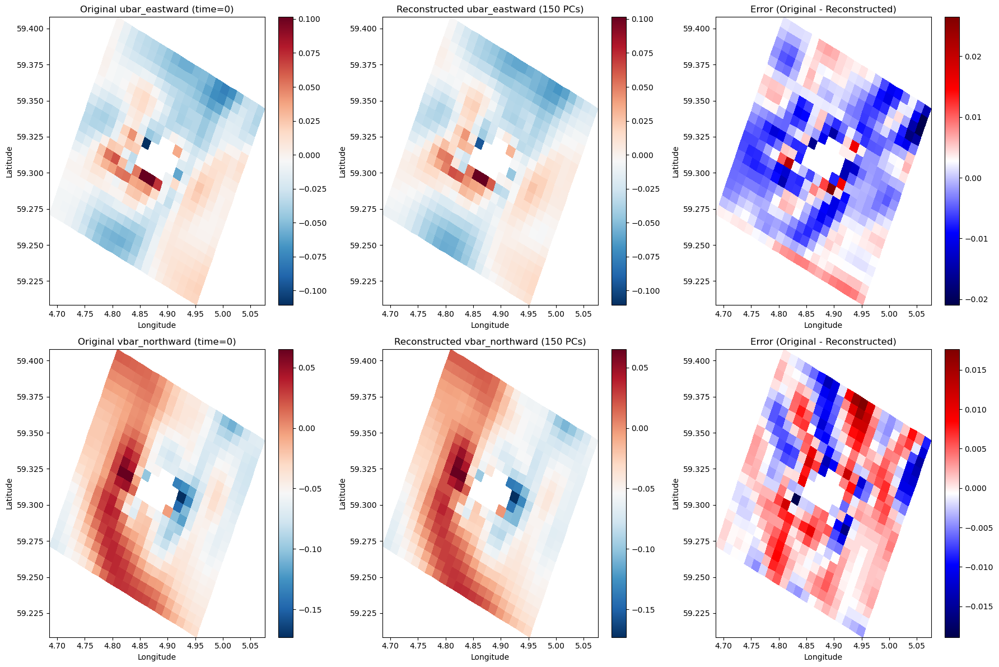

In [179]:
# Plot reconstructed ubar and vbar from SVD
fig, axes = plt.subplots(2, 3, figsize=(18, 12))

time_idx = 0  # Choose a time index to visualize
# Get colorbar limits from original data for consistent scaling
vmin_ubar = data_surface['ubar_eastward'].isel(time=time_idx).min().values
vmax_ubar = data_surface['ubar_eastward'].isel(time=time_idx).max().values
vmin_vbar = data_surface['vbar_northward'].isel(time=time_idx).min().values
vmax_vbar = data_surface['vbar_northward'].isel(time=time_idx).max().values
# Plot ubar_eastward: original, reconstructed, and error
im1 = axes[0, 0].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             data_surface['ubar_eastward'].isel(time=time_idx), 
                             shading='auto', cmap='RdBu_r',vmin=float(vmin_ubar), vmax=float(vmax_ubar))
axes[0, 0].set_title(f'Original ubar_eastward (time={time_idx})')
axes[0, 0].set_xlabel('Longitude')
axes[0, 0].set_ylabel('Latitude')


im1.set_clim(vmin=float(vmin_ubar), vmax=float(vmax_ubar))
plt.colorbar(im1, ax=axes[0, 0])

im2 = axes[0, 1].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             recon_vars['ubar_eastward'][time_idx], 
                             shading='auto', cmap='RdBu_r',vmin=float(vmin_ubar), vmax=float(vmax_ubar))
axes[0, 1].set_title(f'Reconstructed ubar_eastward ({n_pcs} PCs)')
axes[0, 1].set_xlabel('Longitude')
axes[0, 1].set_ylabel('Latitude')
plt.colorbar(im2, ax=axes[0, 1])

error_ubar = data_surface['ubar_eastward'].isel(time=time_idx).values - recon_vars['ubar_eastward'][time_idx]
im3 = axes[0, 2].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             error_ubar, shading='auto', cmap='seismic')
axes[0, 2].set_title('Error (Original - Reconstructed)')
axes[0, 2].set_xlabel('Longitude')
axes[0, 2].set_ylabel('Latitude')
plt.colorbar(im3, ax=axes[0, 2])

# Plot vbar_northward: original, reconstructed, and error
im4 = axes[1, 0].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             data_surface['vbar_northward'].isel(time=time_idx), 
                             shading='auto', cmap='RdBu_r',vmin=float(vmin_vbar), vmax=float(vmax_vbar))
axes[1, 0].set_title(f'Original vbar_northward (time={time_idx})')
axes[1, 0].set_xlabel('Longitude')
axes[1, 0].set_ylabel('Latitude')
plt.colorbar(im4, ax=axes[1, 0])

im5 = axes[1, 1].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             recon_vars['vbar_northward'][time_idx], 
                             shading='auto', cmap='RdBu_r',vmin=float(vmin_vbar), vmax=float(vmax_vbar))
axes[1, 1].set_title(f'Reconstructed vbar_northward ({n_pcs} PCs)')
axes[1, 1].set_xlabel('Longitude')
axes[1, 1].set_ylabel('Latitude')
plt.colorbar(im5, ax=axes[1, 1])

error_vbar = data_surface['vbar_northward'].isel(time=time_idx).values - recon_vars['vbar_northward'][time_idx]
im6 = axes[1, 2].pcolormesh(data_surface['lon'], data_surface['lat'], 
                             error_vbar, shading='auto', cmap='seismic')
axes[1, 2].set_title('Error (Original - Reconstructed)')
axes[1, 2].set_xlabel('Longitude')
axes[1, 2].set_ylabel('Latitude')
plt.colorbar(im6, ax=axes[1, 2])

plt.tight_layout()
plt.show()

## Reservoir Computing (very preliminary)


In [180]:
import numpy as np
from scipy import sparse
from sklearn.metrics import mean_squared_error, r2_score

class ReservoirComputing:
    """
    Reservoir Computing model for predicting u, v, and tke from PCs and position.
    
    Parameters:
    -----------
    n_reservoir : int
        Number of reservoir nodes
    spectral_radius : float
        Spectral radius of the reservoir weight matrix
    input_scaling : float
        Scaling factor for input weights
    ridge_param : float
        Ridge regression parameter for output training
    """
    
    def __init__(self, n_reservoir=500, spectral_radius=0.9, 
                 input_scaling=0.5, ridge_param=1e-6, random_state=42):
        self.n_reservoir = n_reservoir
        self.spectral_radius = spectral_radius
        self.input_scaling = input_scaling
        self.ridge_param = ridge_param
        self.random_state = random_state
        
        np.random.seed(random_state)
        
        # Initialize reservoir (will be set during fit)
        self.W_in = None
        self.W = None
        self.W_out = None
        self.state = None
        
    def _initialize_reservoir(self, n_inputs):
        """Initialize reservoir weights"""
        # Input weights (reservoir x (n_inputs + 1 for bias))
        self.W_in = np.random.randn(self.n_reservoir, n_inputs + 1) * self.input_scaling
        
        # Reservoir weights (sparse for efficiency)
        W = sparse.random(self.n_reservoir, self.n_reservoir, 
                          density=0.1, random_state=self.random_state)
        W = W.toarray()
        
        # Scale to desired spectral radius
        eigenvalues = np.linalg.eigvals(W)
        W = W * (self.spectral_radius / np.max(np.abs(eigenvalues)))
        self.W = W
        
        # Initialize reservoir state
        self.state = np.zeros(self.n_reservoir)
    
    def _update_state(self, u):
        """Update reservoir state with input u"""
        # Add bias term
        u_bias = np.append(u, 1.0)
        
        # Update: state(t+1) = tanh(W_in * u(t) + W * state(t))
        self.state = np.tanh(self.W_in @ u_bias + self.W @ self.state)
        return self.state
    
    def fit(self, X_train, Y_train, washout=100):
        """
        Train the reservoir computing model
        
        Parameters:
        -----------
        X_train : array-like, shape (n_samples, n_features)
            Input features (PCs + position)
        Y_train : array-like, shape (n_samples, n_outputs)
            Target outputs (u, v, tke at each position)
        washout : int
            Number of initial samples to discard for washout
        """
        n_samples, n_inputs = X_train.shape
        n_outputs = Y_train.shape[1]
        
        # Initialize reservoir
        self._initialize_reservoir(n_inputs)
        
        # Collect reservoir states
        states = np.zeros((n_samples, self.n_reservoir))
        
        for i in range(n_samples):
            states[i] = self._update_state(X_train[i])
        
        # Remove washout period
        states = states[washout:]
        Y_train = Y_train[washout:]
        
        # Add bias to states
        states_bias = np.column_stack([states, np.ones(states.shape[0])])
        
        # Train output weights using ridge regression
        # W_out = (S^T S + lambda I)^-1 S^T Y
        S = states_bias
        self.W_out = np.linalg.solve(
            S.T @ S + self.ridge_param * np.eye(S.shape[1]),
            S.T @ Y_train
        )
        
        return self
    
    def predict(self, X_test):
        """
        Predict outputs for test data
        
        Parameters:
        -----------
        X_test : array-like, shape (n_samples, n_features)
            Input features (PCs + position)
            
        Returns:
        --------
        Y_pred : array-like, shape (n_samples, n_outputs)
            Predicted outputs (u, v, tke)
        """
        n_samples = X_test.shape[0]
        
        # Reset state for prediction
        self.state = np.zeros(self.n_reservoir)
        
        # Collect states
        states = np.zeros((n_samples, self.n_reservoir))
        for i in range(n_samples):
            states[i] = self._update_state(X_test[i])
        
        # Add bias
        states_bias = np.column_stack([states, np.ones(states.shape[0])])
        
        # Predict
        Y_pred = states_bias @ self.W_out
        
        return Y_pred

# Prepare training data
# Use first N PCs and normalized position as input
n_pcs_input = 150
time_steps = surface_svd_results['Vt'].shape[1]

# Create input features: [PC1, PC2, ..., PCn, lat_norm, lon_norm]
# For each spatial point at each time
X_all = []
Y_all = []

# Get spatial dimensions
ny, nx = data_surface.dims['Y'], data_surface.dims['X']

# Normalize position
lat_norm = (data_surface['lat'].values - data_surface['lat'].values.min()) / \
           (data_surface['lat'].values.max() - data_surface['lat'].values.min())
lon_norm = (data_surface['lon'].values - data_surface['lon'].values.min()) / \
           (data_surface['lon'].values.max() - data_surface['lon'].values.min())

# For each time step and position, create input-output pairs
for t in range(time_steps):
    pcs_t = surface_svd_results['Vt'][:n_pcs_input, t]
    
    for i in range(ny):
        for j in range(nx):
            # Input: [PC values, normalized lat, normalized lon]
            x_input = np.concatenate([pcs_t, [lat_norm[i, j], lon_norm[i, j]]])
            X_all.append(x_input)
            
            # Output: [u_eastward, v_northward, tke] at this position and time
            y_output = np.array([
                data_surface['u_eastward'].isel(time=t, Y=i, X=j).values,
                data_surface['v_northward'].isel(time=t, Y=i, X=j).values,
                data_surface['tke'].isel(time=t, Y=i, X=j).values
            ])
            Y_all.append(y_output)

X_all = np.array(X_all)
Y_all = np.array(Y_all)

# Handle NaN values
valid_mask = ~np.isnan(Y_all).any(axis=1) & ~np.isnan(X_all).any(axis=1)
X_all = X_all[valid_mask]
Y_all = Y_all[valid_mask]

print(f"Training data shape: X={X_all.shape}, Y={Y_all.shape}")

# Split into train and test
n_train = int(0.8 * len(X_all))
X_train, X_test = X_all[:n_train], X_all[n_train:]
Y_train, Y_test = Y_all[:n_train], Y_all[n_train:]

# Create and train reservoir
rc_model = ReservoirComputing(n_reservoir=500, spectral_radius=0.9, 
                               input_scaling=0.5, ridge_param=1e-5)

print("Training reservoir computing model...")
rc_model.fit(X_train, Y_train, washout=100)


/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/868865611.py:149: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  ny, nx = data_surface.dims['Y'], data_surface.dims['X']


Training data shape: X=(321408, 152), Y=(321408, 3)
Training reservoir computing model...


Making predictions...
u_eastward: MSE=0.036687, R²=-0.6318
v_northward: MSE=0.041142, R²=0.3453
tke: MSE=0.000002, R²=-32.2229


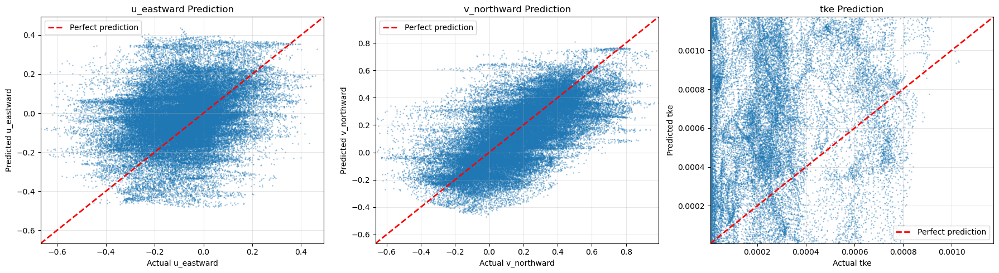

In [181]:

# Make predictions
print("Making predictions...")
Y_pred = rc_model.predict(X_test)

# Calculate errors

for i, var_name in enumerate(['u_eastward', 'v_northward', 'tke']):
    mse = mean_squared_error(Y_test[:, i], Y_pred[:, i])
    r2 = r2_score(Y_test[:, i], Y_pred[:, i])
    print(f"{var_name}: MSE={mse:.6f}, R²={r2:.4f}")

# Plot predictions vs actual
fig, axes = plt.subplots(1, 3, figsize=(18, 5))
var_names = ['u_eastward', 'v_northward', 'tke']

for i, (ax, var_name) in enumerate(zip(axes, var_names)):
    ax.scatter(Y_test[:, i], Y_pred[:, i], alpha=0.3, s=1)
    ax.plot([Y_test[:, i].min(), Y_test[:, i].max()], 
            [Y_test[:, i].min(), Y_test[:, i].max()],
            'r--', lw=2, label='Perfect prediction')
    ax.set_xlim([Y_test[:, i].min(), Y_test[:, i].max()])
    ax.set_ylim([Y_test[:, i].min(), Y_test[:, i].max()])
    ax.set_xlabel(f'Actual {var_name}')
    ax.set_ylabel(f'Predicted {var_name}')
    ax.set_title(f'{var_name} Prediction')
    ax.legend()
    ax.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

## Particle release


In [184]:
data_5

<xarray.Dataset> Size: 233MB
Dimensions:                  (time: 744, s_rho: 35, s_w: 36, depth: 16, Y: 21,
                              X: 21)
Coordinates:
  * X                        (X) float64 168B 2.144e+05 2.152e+05 ... 2.304e+05
  * Y                        (Y) float64 168B 3.984e+05 3.992e+05 ... 4.144e+05
  * depth                    (depth) float64 128B 0.0 3.0 10.0 ... 2e+03 3e+03
  * time                     (time) datetime64[ns] 6kB 2021-05-01 ... 2021-05...
    lat                      (Y, X) float64 4kB 59.21 59.22 59.23 ... 59.4 59.4
    lon                      (Y, X) float64 4kB 4.949 4.955 4.96 ... 4.807 4.812
Dimensions without coordinates: s_rho, s_w
Data variables: (12/26)
    Cs_r                     (time, s_rho) float64 208kB ...
    Cs_w                     (time, s_w) float64 214kB ...
    forecast_reference_time  (time) datetime64[ns] 6kB ...
    hc                       (time) float64 6kB ...
    projection_stere         (time) int32 3kB ...
    AKs                      (time, depth, Y, X) float32 21MB ...
    ...                       ...
    zeta                     (time, Y, X) float32 1MB 0.149 0.149 ... -0.022
    speed                    (time, depth, Y, X) float32 21MB 0.2976 ... nan
    ubar_eastward            (time, Y, X) float64 3MB 0.01799 ... 0.04209
    vbar_northward           (time, Y, X) float64 3MB -0.03491 ... 0.1449
    Uwind_eastward           (time, Y, X) float64 3MB 1.685 1.655 ... 1.8 1.8
    Vwind_northward          (time, Y, X) float64 3MB 2.967 3.004 ... -4.043
Attributes: (12/33)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    his_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    history:                         Sat May  1 16:41:01 2021: ncks -O --4 -d...
    ana_file:                        ROMS/Functionals/ana_btflux.h, ROMS/Func...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    Conventions:                     CF-1.4, SGRID-0.3
    NCO:                             netCDF Operators version 4.8.0 (Homepage...
    DODS_EXTRA.Unlimited_Dimension:  time

In [190]:
data_5

<xarray.Dataset> Size: 233MB
Dimensions:                  (time: 744, s_rho: 35, s_w: 36, depth: 16, Y: 21,
                              X: 21)
Coordinates:
  * X                        (X) float64 168B 2.144e+05 2.152e+05 ... 2.304e+05
  * Y                        (Y) float64 168B 3.984e+05 3.992e+05 ... 4.144e+05
  * depth                    (depth) float64 128B 0.0 3.0 10.0 ... 2e+03 3e+03
  * time                     (time) datetime64[ns] 6kB 2021-05-01 ... 2021-05...
    lat                      (Y, X) float64 4kB 59.21 59.22 59.23 ... 59.4 59.4
    lon                      (Y, X) float64 4kB 4.949 4.955 4.96 ... 4.807 4.812
Dimensions without coordinates: s_rho, s_w
Data variables: (12/26)
    Cs_r                     (time, s_rho) float64 208kB -0.9831 ... -7.313e-06
    Cs_w                     (time, s_w) float64 214kB -1.0 -0.9616 ... 0.0
    forecast_reference_time  (time) datetime64[ns] 6kB 2021-05-01 ... 2021-05-31
    hc                       (time) float64 6kB 20.0 20.0 20.0 ... 20.0 20.0
    projection_stere         (time) int32 3kB -2147483647 ... -2147483647
    AKs                      (time, depth, Y, X) float32 21MB 0.0 0.0 ... nan
    ...                       ...
    zeta                     (time, Y, X) float32 1MB 0.149 0.149 ... -0.022
    speed                    (time, depth, Y, X) float32 21MB 0.2976 ... nan
    ubar_eastward            (time, Y, X) float64 3MB 0.01799 ... 0.04209
    vbar_northward           (time, Y, X) float64 3MB -0.03491 ... 0.1449
    Uwind_eastward           (time, Y, X) float64 3MB 1.685 1.655 ... 1.8 1.8
    Vwind_northward          (time, Y, X) float64 3MB 2.967 3.004 ... -4.043
Attributes: (12/33)
    file:                            /home/metno_op/run/norkyst-800m_2017/oce...
    type:                            ROMS/TOMS history file
    title:                           NorKyst-800m - ROMS
    var_info:                        /home/metno_op/sea/ROMS/metroms/apps/com...
    rst_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    his_file:                        /home/metno_op/run/norkyst-800m_2017/oce...
    ...                              ...
    history:                         Sat May  1 16:41:01 2021: ncks -O --4 -d...
    ana_file:                        ROMS/Functionals/ana_btflux.h, ROMS/Func...
    CPP_options:                     NORKYST800M, ADD_FSOBC, ADD_M2OBC, ALBED...
    Conventions:                     CF-1.4, SGRID-0.3
    NCO:                             netCDF Operators version 4.8.0 (Homepage...
    DODS_EXTRA.Unlimited_Dimension:  time

In [187]:
from scipy.interpolate import interpn

def get_velocity_at_position(t, x, y, z, data=data_5):
    """
    Interpolate u and v velocities at given time, position (x, y in grid coordinates), and depth z.
    
    Parameters:
    -----------
    t : float
        Time index (can be fractional)
    x : float
        X grid coordinate
    y : float
        Y grid coordinate  
    z : float
        Depth in meters (positive down)
    data : xarray.Dataset
        Dataset containing u and v velocity fields
        
    Returns:
    --------
    u, v : float
        Interpolated eastward and northward velocities in m/s
    """
    
    # Use xarray's interp method for cleaner interpolation
    u_interp = data['u'].interp(
        time=t,
        depth=z,
        Y=y,
        X=x,
        method='linear'
    ).values
    
    v_interp = data['v'].interp(
        time=t,
        depth=z,
        Y=y,
        X=x,
        method='linear'
    ).values

    w_interp = data['w'].interp(
        time=t,
        depth=z,
        Y=y,
        X=x,
        method='linear'
    ).values
    
    # Handle NaN values (out of bounds or land)
    if np.isnan(u_interp):
        u_interp = 0.0
    if np.isnan(v_interp):
        v_interp = 0.0
    if np.isnan(w_interp):
        w_interp = 0.0
    
    return float(u_interp), float(v_interp), float(w_interp)

# Example usage:
t_test = data_5.time[100].values  # Time index
x_test = 220000.0  # X coordinate
y_test = 405000.0  # Y coordinate  
z_test = 5.0  # Depth in meters

u_vel, v_vel , w_vel = get_velocity_at_position(t_test, x_test, y_test, z_test)
print(f"At t={t_test}, x={x_test}, y={y_test}, z={z_test}m:")
print(f"  u = {u_vel:.4f} m/s")
print(f"  v = {v_vel:.4f} m/s")
print(f"  w = {w_vel:.6f} m/s")

At t=2021-05-05T04:00:00.000000000, x=220000.0, y=405000.0, z=5.0m:
  u = -0.2185 m/s
  v = 0.0919 m/s
  w = 0.000332 m/s


In [188]:
import numpy as np
import matplotlib.pyplot as plt
from scipy.interpolate import RegularGridInterpolator

# Monte Carlo particle tracking with sinking
n_particles = 100
w_sink = 0.005  # m/s
dt_particle = 600 # seconds

# Get grid dimensions
NY, NX = data_5.dims['Y'], data_5.dims['X']
T = data_5.dims['time']-100

# Extract coordinate arrays
lon = data_5['lon'].values  # Shape (Y, X)
lat = data_5['lat'].values  # Shape (Y, X)
X_coords = data_5['X'].values  # 1D array
Y_coords = data_5['Y'].values  # 1D array

# Identify land mask
u_seq = data_5['u'].isel(depth=0).values  # (T,Z Y, X)
v_seq = data_5['v'].isel(depth=0).values
land_mask = np.all(u_seq == 0, axis=0) & np.all(v_seq == 0, axis=0)

# Release location in grid coordinates (Y, X)
island_y, island_x = np.where(land_mask)
if island_y.size > 0:
    island_center_y = int(np.mean(island_y))
    island_center_x = int(np.mean(island_x))
    release_y_i = island_center_y - 10  # 3 grid points south
    release_x_i = island_center_x
else:
    release_y_i = NY // 2# - 7
    release_x_i = 4 # NX // 2 - 7

release_depth = 0.0
release_x=X_coords[release_x_i]
release_y=Y_coords[release_y_i]

# Convert to lat/lon for display
release_lat = lat[release_y_i, release_x_i]
release_lon = lon[release_y_i, release_x_i]

print(f"Release location: Y={release_y}, X={release_x}")
print(f"  (lat={release_lat:.4f}°N, lon={release_lon:.4f}°E)")
print(f"Sinking rate: {w_sink} m/s = {w_sink*86400:.1f} m/day")

# Random release times
np.random.seed(42)
release_times = np.random.randint(0, T, size=n_particles)

# Get bathymetry
h_data = data_5['h']
if 'time' in h_data.dims:
    h_bathy = h_data.isel(time=0).values
else:
    h_bathy = h_data.values

print(f"Bathymetry shape: {h_bathy.shape}")

# Interpolator for bathymetry using Y, X coordinates
h_interp = RegularGridInterpolator(
    (Y_coords, X_coords), 
    h_bathy, 
    bounds_error=False, 
    fill_value=np.nan,
    method='linear'
)

# Time step in data
dt_seconds = 3600.0  # 1 hour

# Grid spacing (in grid units, = 1.0)
dy_grid = 1.0
dx_grid = 1.0

# Storage
final_xs = np.full(n_particles, np.nan)
final_ys = np.full(n_particles, np.nan)
final_depths = np.full(n_particles, np.nan)
travel_times = np.full(n_particles, np.nan)



# Track particles
for p in range(n_particles):
    x = float(release_x)
    y = float(release_y)
    z = release_depth
    t_rel = data_5.time[release_times[p]].values
    
    max_steps = 100000
    
    for step in range(max_steps):
        t_float = t_rel + np.timedelta64(step * dt_particle,'s')
        
        if t_float >= data_5.time[T-1].values:
            break
        
        # Check bounds
        if x < X_coords.min() or x >= X_coords.max() or y < Y_coords.min() or y >= Y_coords.max():
            print(f"Particle {p} out of bounds at step {step}")
            print(f"x={x}, y={y}")  
            print(f"X range: 0 to {NX-1}, Y range: 0 to {NY-1}")
            
            break
        
        # Get bathymetry at current position
        h_local = h_interp((y, x))
        
        if not np.isfinite(h_local):
            print(f"Particle {p} over land at step {step}")
            print(f"x={x}, y={y}")
            print(f"h_local={h_local}")
            break
        
        # Check if hit seafloor
        if z >= h_local:
            z = h_local
            final_xs[p] = x
            final_ys[p] = y
            final_depths[p] = z
            travel_times[p] = step * dt_particle
            break
        
        # Get velocity in m/s
        u_vel, v_vel, w_vel = get_velocity_at_position(t_float, x, y, z)
        
        # Get local lat/lon spacing at current position
        x=x+(u_vel * dt_particle) 
        y=y+(v_vel * dt_particle)
        z=z+(w_sink- w_vel) * dt_particle
        
         
        
        if step == max_steps - 1:
            h_local = h_interp((y, x))
            if np.isfinite(h_local) and z >= h_local:
                z = h_local
                final_xs[p] = x
                final_ys[p] = y
                final_depths[p] = z
                travel_times[p] = step * dt_particle

# Results
valid = np.isfinite(final_xs) & np.isfinite(final_ys)
n_valid = valid.sum()

print(f"\nParticles that reached seafloor: {n_valid}/{n_particles} ({100*n_valid/n_particles:.1f}%)")
if n_valid > 0:
    print(f"Mean travel time: {np.nanmean(travel_times[valid])/3600:.1f} hours")
    print(f"Mean final depth: {np.nanmean(final_depths[valid]):.1f} m")
    print(f"Mean final position: Y={np.nanmean(final_ys[valid]):.2f}, X={np.nanmean(final_xs[valid]):.2f}")
    print(f"Std final position: Y={np.nanstd(final_ys[valid]):.2f}, X={np.nanstd(final_xs[valid]):.2f}")

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/1278527286.py:11: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  NY, NX = data_5.dims['Y'], data_5.dims['X']
/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/1278527286.py:12: FutureWarning: The return type of `Dataset.dims` will be changed to return a set of dimension names in future, in order to be more consistent with `DataArray.dims`. To access a mapping from dimension names to lengths, please use `Dataset.sizes`.
  T = data_5.dims['time']-100


Release location: Y=406400.0, X=217600.0
  (lat=59.2692°N, lon=4.8454°E)
Sinking rate: 0.005 m/s = 432.0 m/day
Bathymetry shape: (21, 21)
Particle 11 out of bounds at step 44
x=214390.44910154803, y=405720.27339403826
X range: 0 to 20, Y range: 0 to 20
Particle 12 out of bounds at step 35
x=214374.7389618744, y=405514.8814248528
X range: 0 to 20, Y range: 0 to 20
Particle 14 out of bounds at step 42
x=214363.91206380422, y=406109.33561311505
X range: 0 to 20, Y range: 0 to 20
Particle 24 out of bounds at step 42
x=214390.98523955673, y=406148.72841137525
X range: 0 to 20, Y range: 0 to 20
Particle 31 out of bounds at step 34
x=214378.42605192348, y=404356.24411015405
X range: 0 to 20, Y range: 0 to 20
Particle 46 out of bounds at step 26
x=214332.8475364472, y=405264.51647127635
X range: 0 to 20, Y range: 0 to 20
Particle 61 out of bounds at step 21
x=214396.95883992955, y=405415.48115117673
X range: 0 to 20, Y range: 0 to 20
Particle 69 out of bounds at step 30
x=214354.10920749686, y

/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_22104/922781807.py:9: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(lon, lat, land_mask, levels=[0.5], colors='gray',


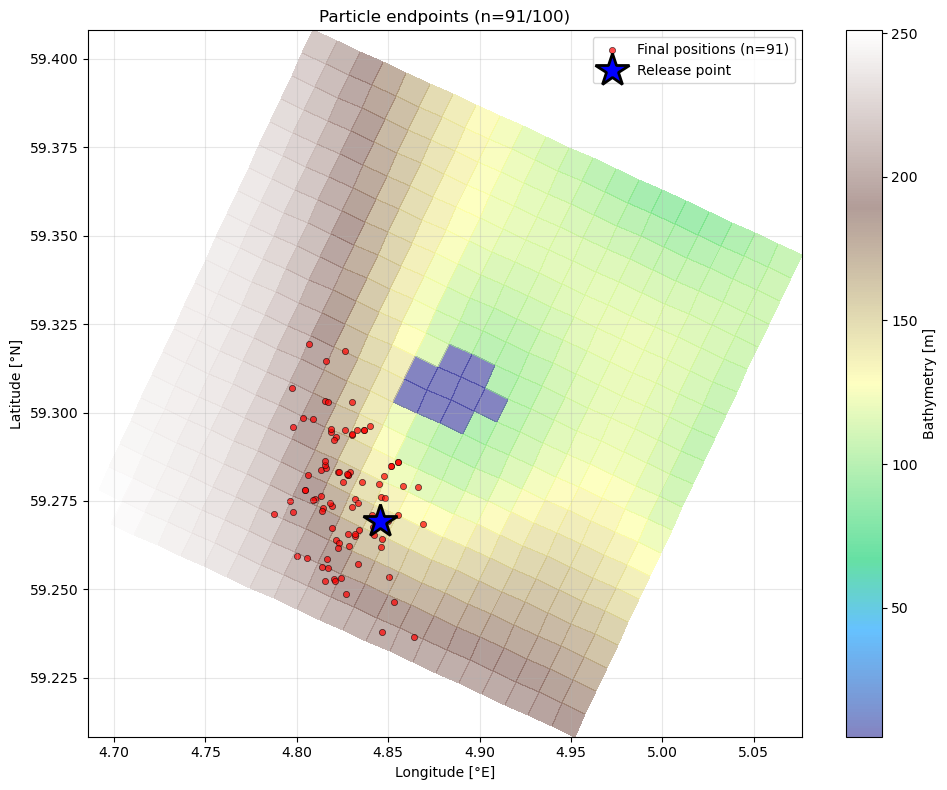

In [190]:
# Scatter plot of final particle positions
plt.figure(figsize=(10, 8))

# Plot bathymetry as background
im = plt.pcolormesh(lon, lat, h_bathy, shading='auto', cmap='terrain', alpha=0.6)
plt.colorbar(im, label='Bathymetry [m]')

# Show land mask
plt.contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
            linewidths=2, linestyles='--', label='Land')

# Convert final grid coordinates to lat/lon for valid particles
if n_valid > 0:
    # Create interpolators for lat/lon from grid coordinates
    from scipy.interpolate import RegularGridInterpolator
    lat_interp = RegularGridInterpolator((Y_coords, X_coords), lat, 
                                          bounds_error=False, fill_value=np.nan)
    lon_interp = RegularGridInterpolator((Y_coords, X_coords), lon, 
                                          bounds_error=False, fill_value=np.nan)
    
    # Get lat/lon for valid final positions
    final_lats = np.array([lat_interp((final_ys[i], final_xs[i])) 
                           for i in range(n_particles) if valid[i]])
    final_lons = np.array([lon_interp((final_ys[i], final_xs[i])) 
                           for i in range(n_particles) if valid[i]])
    
    # Scatter plot of final positions
    plt.scatter(final_lons, final_lats, 
                c='red', s=20, alpha=0.7, edgecolors='k', linewidths=0.5,
                label=f'Final positions (n={n_valid})')

# Mark release location
plt.plot(release_lon, release_lat, 'b*', markersize=25, 
         markeredgecolor='k', markeredgewidth=2, label='Release point')



plt.xlabel('Longitude [°E]')
plt.ylabel('Latitude [°N]')
plt.title(f'Particle endpoints (n={n_valid}/{n_particles})')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()

### Parallel calculations

In [191]:

def track_particle_to_seafloor(release_time_idx, release_x, release_y, 
                                release_depth=0.0, w_sink=0.005, dt_particle=600,
                                max_steps=100000, data=data_5):
    """
    Track a single particle from release position to seafloor.
    
    Parameters:
    -----------
    release_time_idx : int
        Time index for particle release
    release_x : float
        X coordinate (in grid units)
    release_y : float
        Y coordinate (in grid units)
    release_depth : float
        Initial depth in meters (default 0.0 for surface)
    w_sink : float
        Sinking velocity in m/s (default 0.005)
    dt_particle : float
        Time step in seconds (default 600)
    max_steps : int
        Maximum number of integration steps
    data : xarray.Dataset
        Dataset containing velocity fields
        
    Returns:
    --------
    dict with keys:
        'final_x': final X position (or nan if didn't reach seafloor)
        'final_y': final Y position (or nan)
        'final_depth': final depth in meters (or nan)
        'travel_time': travel time in seconds (or nan)
        'reached_seafloor': boolean
    """
    # Get grid info
    X_coords = data['X'].values
    Y_coords = data['Y'].values
    T = data.sizes['time']
    NX = data.sizes['X']
    NY = data.sizes['Y']
    
    # Get bathymetry
    h_data = data['h']
    if 'time' in h_data.dims:
        h_bathy = h_data.isel(time=0).values
    else:
        h_bathy = h_data.values
    
    # Interpolator for bathymetry
    h_interp = RegularGridInterpolator(
        (Y_coords, X_coords), 
        h_bathy, 
        bounds_error=False, 
        fill_value=np.nan,
        method='linear'
    )
    
    # Initialize particle
    x = float(release_x)
    y = float(release_y)
    z = release_depth
    t_rel = data.time[release_time_idx].values
    
    for step in range(max_steps):
        t_float = t_rel + np.timedelta64(step * dt_particle, 's')
        
        # Check if exceeded simulation time
        if t_float >= data.time[T-1].values:
            break
        
        # Check bounds
        if x < X_coords.min() or x >= X_coords.max() or \
           y < Y_coords.min() or y >= Y_coords.max():
            break
        
        # Get bathymetry at current position
        h_local = h_interp((y, x))
        
        if not np.isfinite(h_local):
            break
        
        # Check if hit seafloor
        if z >= h_local:
            return {
                'final_x': x,
                'final_y': y,
                'final_depth': h_local,
                'travel_time': step * dt_particle,
                'reached_seafloor': True
            }
        
        # Get velocity in m/s
        u_vel, v_vel, w_vel = get_velocity_at_position(t_float, x, y, z)
        
        # Update position
        x = x + (u_vel * dt_particle)
        y = y + (v_vel * dt_particle)
        z = z + (w_sink - w_vel) * dt_particle
    
    # Didn't reach seafloor
    return {
        'final_x': np.nan,
        'final_y': np.nan,
        'final_depth': np.nan,
        'travel_time': np.nan,
        'reached_seafloor': False
    }
  


In [ ]:
from joblib import Parallel, delayed
import numpy as np

# Run single particle tracking example
T = data_5.sizes['time'] - 100
n_particles = 100
release_times = np.random.randint(0, T, size=n_particles)
release_x_i = 6
release_y_i = NY // 2-5
release_x = X_coords[release_x_i]
release_y = Y_coords[release_y_i]
release_lon = lon[release_y_i, release_x_i]
release_lat = lat[release_y_i, release_x_i]
print(f"Tracking {n_particles} particles in parallel using all CPU cores...")

# Run in parallel using joblib (works better in notebooks than multiprocessing)
results = Parallel(n_jobs=-1, verbose=10)(  # n_jobs=-1 uses all CPUs
    delayed(track_particle_to_seafloor)(
        release_time_idx=release_time,
        release_x=release_x,
        release_y=release_y,
        release_depth=0.0,
        w_sink=0.005,
        dt_particle=60,
        max_steps=100000,
        data=data_5
    )
    for release_time in release_times
)

# Merge results
final_xs = np.array([r['final_x'] for r in results])
final_ys = np.array([r['final_y'] for r in results])
final_depths = np.array([r['final_depth'] for r in results])
travel_times = np.array([r['travel_time'] for r in results])
reached_seafloor = np.array([r['reached_seafloor'] for r in results])

print(f"Particles that reached seafloor: {reached_seafloor.sum()}/{n_particles}")

Tracking 100 particles in parallel using all CPU cores...


[Parallel(n_jobs=-1)]: Using backend LokyBackend with 12 concurrent workers.


Converted 100 positions to lat/lon
Lat range: 59.2283 to 59.3112
Lon range: 4.8594 to 4.9481


/var/folders/mt/6thqwmbj5lvfz_9z7jnfcxt80000gn/T/ipykernel_91302/2776687577.py:49: UserWarning: The following kwargs were not used by contour: 'label'
  plt.contour(lon, lat, land_mask, levels=[0.5], colors='gray',


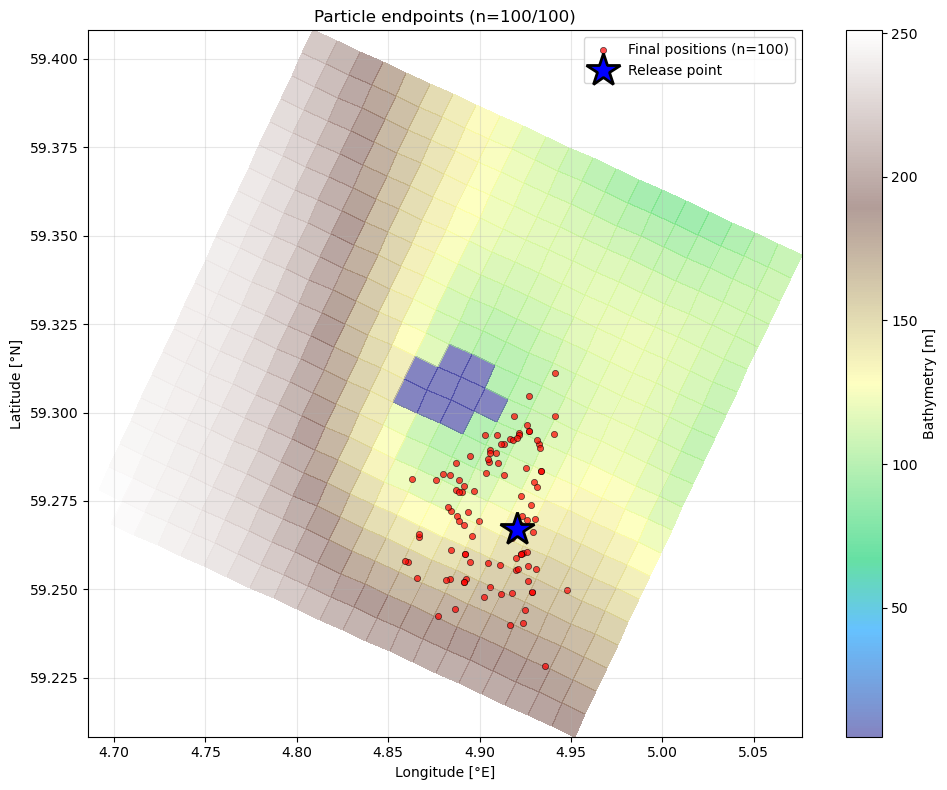

In [ ]:
# Convert final positions from X,Y grid coordinates to lat/lon
if reached_seafloor.sum() > 0:
    final_lons = np.full(n_particles, np.nan)
    final_lats = np.full(n_particles, np.nan)
    
    for p in range(n_particles):
        if reached_seafloor[p]:
            # Get grid position in X, Y coordinates
            x_pos = final_xs[p]
            y_pos = final_ys[p]
            
            # Convert X coordinate to array index
            x_idx = np.searchsorted(X_coords, x_pos) - 1
            x_idx = np.clip(x_idx, 0, NX - 2)
            x_frac = (x_pos - X_coords[x_idx]) / (X_coords[x_idx + 1] - X_coords[x_idx])
            
            # Convert Y coordinate to array index
            y_idx = np.searchsorted(Y_coords, y_pos) - 1
            y_idx = np.clip(y_idx, 0, NY - 2)
            y_frac = (y_pos - Y_coords[y_idx]) / (Y_coords[y_idx + 1] - Y_coords[y_idx])
            
            # Bilinear interpolation for lon and lat
            lon_interp = ((1 - x_frac) * (1 - y_frac) * lon[y_idx, x_idx] +
                          x_frac * (1 - y_frac) * lon[y_idx, x_idx + 1] +
                          (1 - x_frac) * y_frac * lon[y_idx + 1, x_idx] +
                          x_frac * y_frac * lon[y_idx + 1, x_idx + 1])
            
            lat_interp = ((1 - x_frac) * (1 - y_frac) * lat[y_idx, x_idx] +
                          x_frac * (1 - y_frac) * lat[y_idx, x_idx + 1] +
                          (1 - x_frac) * y_frac * lat[y_idx + 1, x_idx] +
                          x_frac * y_frac * lat[y_idx + 1, x_idx + 1])
            
            final_lons[p] = lon_interp
            final_lats[p] = lat_interp
    
    valid_lons = np.isfinite(final_lons)
    n_converted = valid_lons.sum()
    print(f"Converted {n_converted} positions to lat/lon")
    print(f"Lat range: {np.nanmin(final_lats[valid_lons]):.4f} to {np.nanmax(final_lats[valid_lons]):.4f}")
    print(f"Lon range: {np.nanmin(final_lons[valid_lons]):.4f} to {np.nanmax(final_lons[valid_lons]):.4f}")
# Scatter plot of final particle positions
plt.figure(figsize=(10, 8))

# Plot bathymetry as background
im = plt.pcolormesh(lon, lat, h_bathy, shading='auto', cmap='terrain', alpha=0.6)
plt.colorbar(im, label='Bathymetry [m]')

# Show land mask
plt.contour(lon, lat, land_mask, levels=[0.5], colors='gray', 
            linewidths=2, linestyles='--', label='Land')

# Recalculate valid mask for current data
valid = np.isfinite(final_lons) & np.isfinite(final_lats)
n_valid = valid.sum()

# Scatter plot of final positions
if n_valid > 0:
    plt.scatter(final_lons[valid], final_lats[valid], 
                c='red', s=20, alpha=0.7, edgecolors='k', linewidths=0.5,
                label=f'Final positions (n={n_valid})')

# Mark release location
plt.plot(release_lon, release_lat, 'b*', markersize=25, 
         markeredgecolor='k', markeredgewidth=2, label='Release point')



plt.xlabel('Longitude [°E]')
plt.ylabel('Latitude [°N]')
plt.title(f'Particle endpoints (n={n_valid}/{n_particles})')
plt.legend()
plt.grid(True, alpha=0.3)
plt.tight_layout()
plt.show()